In [1]:
import tables as tb
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt

import invisible_cities.io.dst_io as dio

from utils.plotting_utils import plot_cloud_voxels, plot_cloud_voxels_and_hits_discrete, plot_3d_hits, plot_3d_vox, plot_label_creator, plot_adaption_hits_to_voxel_scale, plot_3d_hits_discrete, plot_cloud_voxels_and_hits_discrete_blobs, recalculate_barycenter_plot
from utils.blob_distances_utils import get_dist_blob_isaura, get_centers
from   matplotlib.patches   import Patch



In [2]:
path = '/Users/mperez/NEXT/data_labelling/examples/JA_files/'
file = 'merged_beersheba_label_4mm_50scut.h5'

labelled_file = path + file

In [3]:
with tb.open_file(labelled_file) as h5in:
    print(h5in)

/Users/mperez/NEXT/data_labelling/examples/JA_files/merged_beersheba_label_4mm_50scut.h5 (File) ''
Last modif.: 'Mon Apr 25 18:18:33 2022'
Object Tree: 
/ (RootGroup) ''
/DATASET (Group) ''
/DATASET/BeershebaVoxels (Table(5796404,), shuffle, zlib(4)) ''
/DATASET/BinsInfo (Table(1,), shuffle, zlib(4)) ''
/DATASET/EventsInfo (Table(28767,), shuffle, zlib(4)) ''
/DATASET/IsauraInfo (Table(40719,), shuffle, zlib(4)) ''
/DATASET/MCHits (Table(7168681,), shuffle, zlib(4)) ''



In [4]:
MC_hits   = dio.load_dst(labelled_file, 'DATASET', 'MCHits')
beersheba_voxels = dio.load_dst(labelled_file, 'DATASET', 'BeershebaVoxels')
eventInfo = dio.load_dst(labelled_file, 'DATASET', 'EventsInfo')
binsInfo  = dio.load_dst(labelled_file, 'DATASET', 'BinsInfo')
isauraInfo = dio.load_dst(labelled_file, 'DATASET', 'IsauraInfo')

In [ ]:
dist_blob_df, isaura_info_blobs = get_dist_blob_isaura(MC_hits, beersheba_voxels, isauraInfo, binsInfo)

In [5]:
voxel_size = (binsInfo.size_x.values[0], binsInfo.size_y.values[0], binsInfo.size_z.values[0])
start_bin  = (binsInfo.min_x.values[0], binsInfo.min_y.values[0], binsInfo.min_z.values[0])

-- EVENTS WITH TRACK VOXELS OUT OF THE MAIN CLOUD
* 20, 4156: the reconstruction itself makes a gap in the track, so it is interrupted; this is most of the cases in this issue.
* 4123, 17121, 17888: the main cloud (most energetic) is labelled as other, i think because there are various other particles close together and end up adding more energy when counting, but if we look at the MC simulation, the most energetic would be the track i picked. Those are not really a problem bc its only a thing of the ordering of the clouds i guess. (VALE, en estos eventos veo que sucede que la KIN_ENERGY de la partícula en montecarlo tiene cierta energía, y luego la track energy que hago yo sumando la energía de todos sus hits de MC da al revés, o sea más deposición de energía para otra partícula que no es la que tenía más kin energy, pasará algo con esto?? o sea sé que no directamente, pero quizás la nube más energética no se corresponde con la que etiqueté porque sumando la energía ahora de los voxeles da mayor que cuando sumé la energía de las trazas...) VALE SI, LA SUMA DE LOS HITS DE BEERSHEBA DÁ UN VALOR SIMILAR AL DE LA KIN_ENERGY EN EL MC, Y DISTINTA A LA SUMA DE LOS HITS DE MC... POR ESO HAY DICHA CONFUSIÓN.

* 20172: event out of the range of the detector, and the reconstruction is only performed (i think) on the elements that are not cut, and the main track is ignored ---> solve with a fiducial cut that eliminates the events with hits out of it

-- EVENTS WITH BLOB VOXELS OUT OF THE MAIN CLOUD
* 309: ?? parece que la colocación/correspondencia de los voxeles se hizo mal?? No entiendo, pero es posible que tenga que ver con traza cortada o algo así pq esos siempre me los coloca mal
* 436: a simple vista no está cortada pero la reconstrucción es raruna y en z está muy cerca de 1 el mínimo por lo que probablemente venga de no eliminar los eventos cerca de los bordes :)
* 16511: como para la traza, pertenece a la cloud no principal pero realmente no hay nigún corte simplemente es que hay otra cloud más energética que es clase other. Parece que esto pasa para los eventos de bkg más que na PERO no siempre, el 25730 es de señal x ejemplo (o quizás solo me daba la sensación porque hay más eventos de bkg en general y punto)

-----------------------------------------

-- EVENTS WITH 2 DIFFERENT ELEMENTS LABELLED AS TRACK
* 5, 18: interrupted by otherclass; those may be fixed counting the otherclass blobs in the main track as part of the "continuity" of the track...
* the majority will coincide with the events with track voxels out of the main cloud

-- EVENTS WITH 3 DIFFERENT ELEMENTS LABELLED AS TRACK
* 469, 23670: reconstruction gaps
* 10368: twisted track !!!!!!!!!!!!

-- EVENTS WITH 4 DIFFERENT ELEMENTS LABELLED AS TRACK
* 6191, 21935: reconstruction gaps (se ven muy bien)

-- EVENTS WITH 5 DIFFERENT ELEMENTS LABELLED AS TRACK
* 16853: event out of borders

-----------------------------------------

-- EVENTS WITH BINCLASS 0 AND 2 BLOBS
* 996: weird reconstruction makes blob labels to be separated
* 25981: a twist makes MC not coincide in one voxel that is relabelled causing a desconnection

-- EVENTS WITH BINCLASS 0 AND 0 BLOBS
* 2572, 23358, 27695: event out of the limits

-- EVENTS WITH BINCLASS 1 AND 1 BLOBS
* 24, 18930: the beersheba reconstruction gets so close (with the clouds) that 2 blobs end up counting as 1 (it is not that much that the track is twisted, but obviously it affects)
* 4961, 25982: twisted track

-- EVENTS WITH BINCLASS 1 AND 0 BLOBS
* 5083, 8064, 8729,  14455, 21670, 23203, 26313: event out of the limits
* 10123, 15679: reconstruction seems to be similar to the MC track but the positions are a bit drifted. Btw, the track is reconstructed but with some gaps and a lot of ghosts appear so maybe the error is in the recons. They look like the cases where part of the event is out of the limits but when looking the positions they aren't out of the limits... MAYBE there was a tiny thing out of the limits that doesn't even appear when looking the event (thats why in these events i dont see hits next to the border) ----> THIS IS THE CASE I SAW WHERE THE EVENT IS KIND OF DRIFTED AND DOES WEIRD THINGS

-- EVENTS WITH BINCLASS 1 AND 3 BLOBS
* 5613, 20500: some MC voxel doesn't coincide in one voxel that is relabelled causing a desconnection
* 10360: bad reconstruction at one end

Una cosa así rápida que se me ocurre para filtrar los eventos out of limits es decir pues los que tienen EXCLUSIVAMENTE clases neighbour es pq el MC no correspondía ergo es una cosa totalmente distinta (y por tanto una reconstrucción de un evento cortado, por lo que vi estos días) ---> NO, pq los que relleno yo como paliativo de voxeles MC que quedan descolgaos los pongo como clase original, quizás debería cambiar eso

Lo de RELABELLING de los voxeles que no se asignaron por MC me está causando alguno de los problemillas pq hace que aparezcan cosites fuera de sitio ( no muchas pero bueno...); lo malo es que en muchos casos es necesaria......

También veo que de algún parámetro de beersheba tiene que venir las dimensiones del detector pq no tiene sentido que mi MC (en el que se ven hits, simplemente yo los corto en cierto punto) sea reconstruido como si algunas partes no estuvieran!! Rollo en el evento 27695 por ejemplo, se sale fuera una trazita otherclass pero luego en la reconstrucción NO SE RECONSTRUYE NADA DE ESA TRAZA, en lugar de reconstruirse el trozo que está dentro. Quizás beersheba mira de alguna forma en los datos de esmeralda/MC si la traza está dentro del detector entera, y si no lo está pues pasa de ella o algo así. Lo que hace esto es que después no coincidan bien los voxeles MC y los de beersheba (pq la imagen cambia de dimensiones obviamente)

EVENTS OUT OF FIDUCIAL VOLUME:

* 1992: este evento por ejemplo tiene sólo unos pocos otherhits cercanos a los bordes del detector.. entonces, la reconstrucción se hace bien PERO lo que falla es que al no reconstruir esos hits, desplaza el evento y hace imposible la coincidencia entre los MC voxeles y los beersheba voxeles!!

In [34]:
def plot_full_event(nevent, MC_hits, beersheba_voxels, isaura_info_blobs, eventInfo, binsInfo, path, show_all = False, show_blobs = False):
    print('==============================================================')
    print('EVENT {}'.format(nevent))
    print('==============================================================')
    voxel_size = (binsInfo.size_x.values[0], binsInfo.size_y.values[0], binsInfo.size_z.values[0])
    start_bin  = (binsInfo.min_x.values[0], binsInfo.min_y.values[0], binsInfo.min_z.values[0])
    
    ids = eventInfo.dataset_id.unique()
    dataset_id = ids[nevent]

    #Load labelled MC hits, beersheba voxels and isaura info
    event_MC_hits = MC_hits[MC_hits.dataset_id == dataset_id]
    event_beersh_vox = beersheba_voxels[beersheba_voxels.dataset_id == dataset_id]
    
    event_blobs = isaura_info_blobs[isaura_info_blobs.dataset_id == dataset_id]
    
    #Barycenter regrouping
    if event_blobs.binclass.values[0] == 0:
        if event_blobs.elem_count.values[0] > 1:
            event_blobs = recalculate_barycenter_plot(event_blobs[event_blobs.elem == '3_0'])
            
    else:
        if event_blobs.elem_count.values[0] > 2:
            event_blobs0 = event_blobs[event_blobs.elem == '3_0']
            event_blobs1 = recalculate_barycenter_plot(event_blobs[event_blobs.elem != '3_0'])
            event_blobs = event_blobs0.append(event_blobs1)
            
    #Take the original file name
    basename = eventInfo[eventInfo.dataset_id == dataset_id].basename.item()
    original_file =  path + basename
    
    #Take original file name labelled
    label_original_file = path + eventInfo[eventInfo.dataset_id == dataset_id].label_basename.item()
    event_id_bersh = eventInfo[eventInfo.dataset_id == dataset_id].event_id.item()
    
    #Load beersheba hits
    beersheba_hits = dio.load_dst(original_file, 'DECO', 'Events')
    event_beersh_hits = beersheba_hits[beersheba_hits.event == event_id_bersh]
    
    #Load eventInfo for the labelled file so we can recover the event id in this file
    label_eventInfo = dio.load_dst(label_original_file, 'DATASET', 'EventsInfo')
    label_event_id = label_eventInfo[(label_eventInfo.event_id == event_id_bersh) & (label_eventInfo.basename == basename)].dataset_id.item()
    
    #Load MC voxels
    MC_voxels = dio.load_dst(label_original_file, 'DATASET', 'MCVoxels')
    event_MC_voxels = MC_voxels[MC_voxels.dataset_id == label_event_id]
    
    
    #Plot
    if show_all:
        plot_3d_hits(event_MC_hits, value = 'particle_id') 
        plot_3d_hits_discrete(event_MC_hits)
        plot_cloud_voxels_and_hits_discrete(event_MC_voxels, pd.DataFrame(), voxel_size, start_bin, coords = ['x', 'y', 'z'], opacity = [1, 0.5])

        plot_3d_hits(event_beersh_hits, value = 'E', coords = ['X', 'Y', 'Z'])
        plot_3d_vox(event_beersh_vox, voxel_size, value = 'energy', coords = ['xbin', 'ybin', 'zbin'])

        plot_cloud_voxels_and_hits_discrete(event_beersh_vox, pd.DataFrame(), voxel_size, start_bin, opacity = [1, 0])
        plot_cloud_voxels_and_hits_discrete(event_beersh_vox, pd.DataFrame(), voxel_size, start_bin, opacity = [1, 0.6])

    plot_cloud_voxels_and_hits_discrete(event_beersh_vox, event_MC_hits, voxel_size, start_bin, opacity = [0.6, 0.6, 1])
    
    if show_blobs:
        plot_cloud_voxels_and_hits_discrete_blobs(event_beersh_vox, event_MC_hits, event_blobs, voxel_size, start_bin, linewidth = 0.05, opacity = [0.05, 0.05, 1])


    print('')
    print('')
    print('')

Show labelling event
EVENT 80


<IPython.core.display.Javascript object>


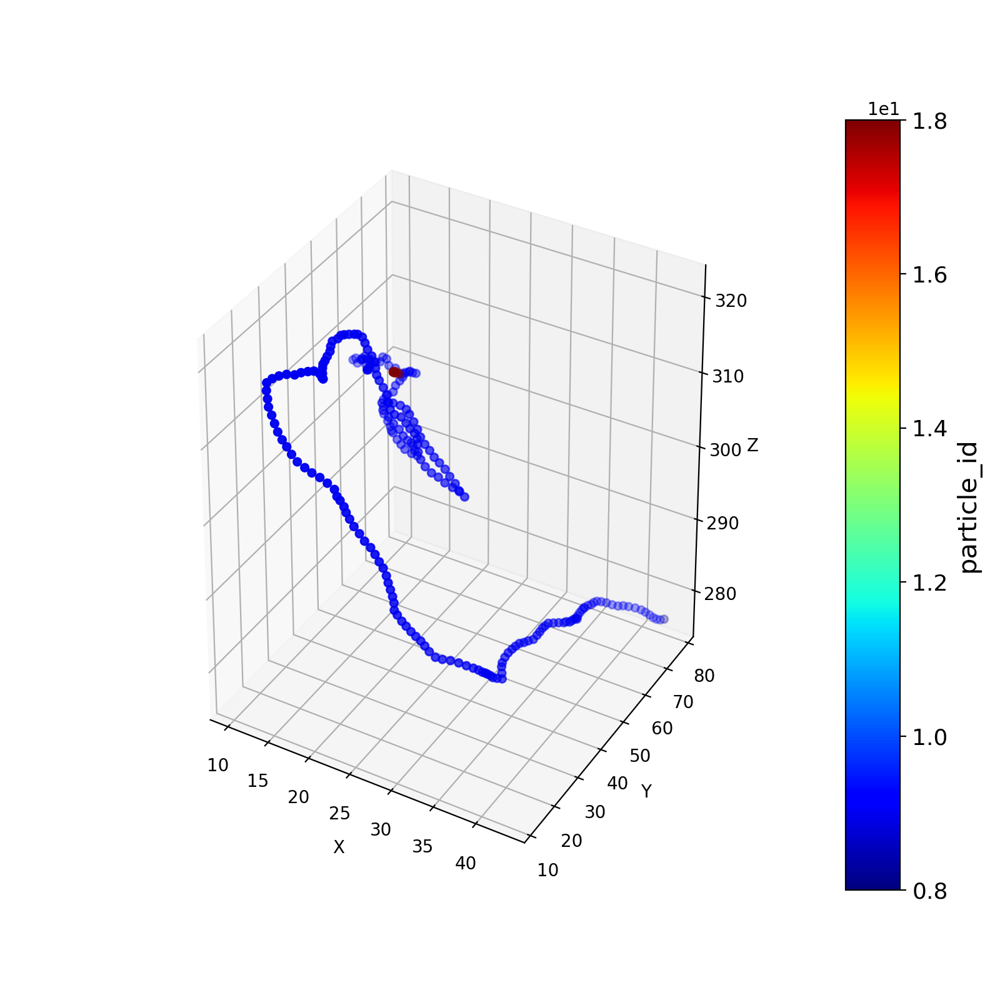

<IPython.core.display.Javascript object>


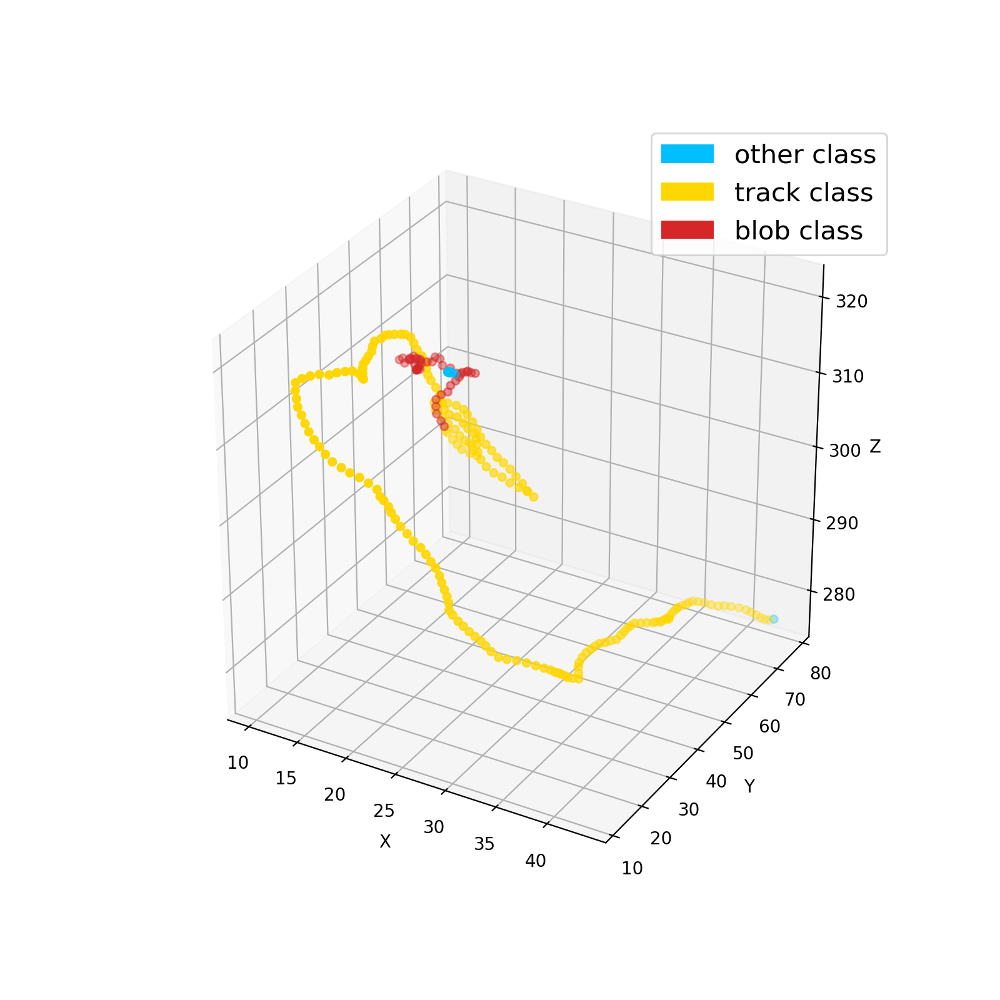

<IPython.core.display.Javascript object>


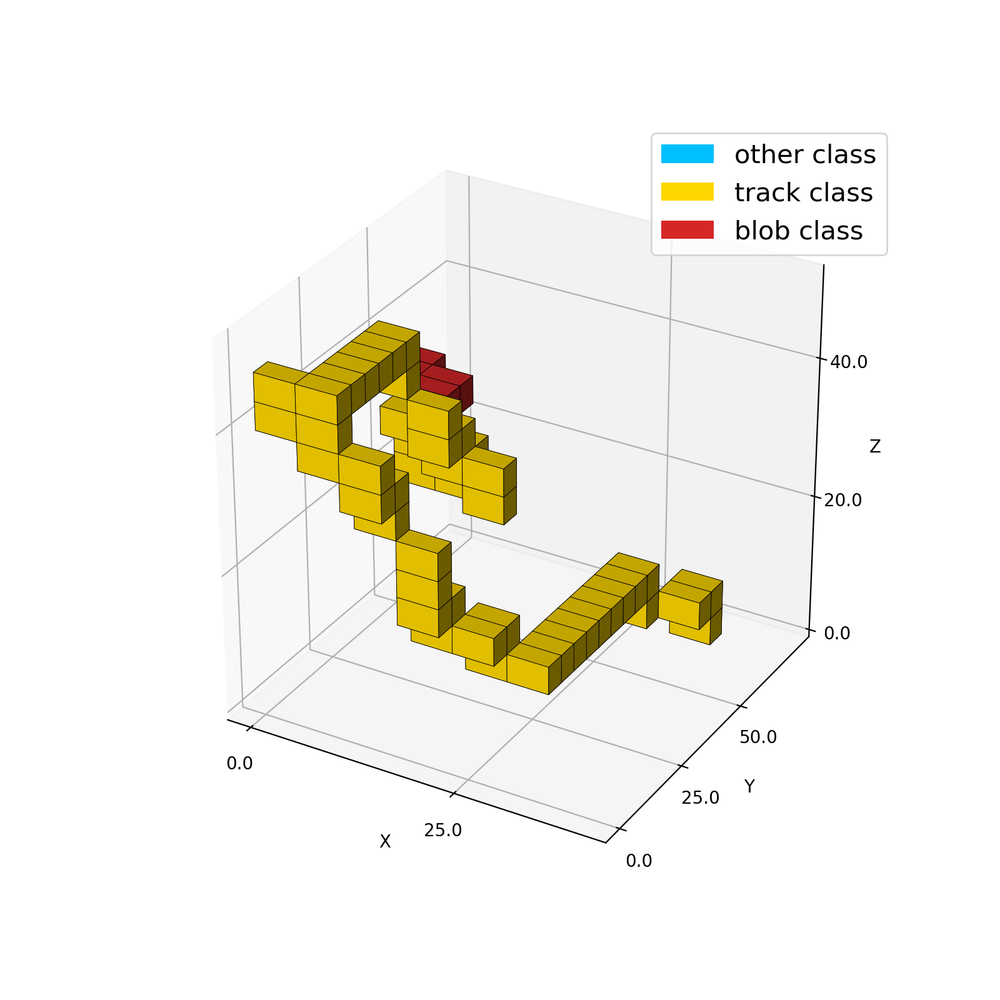

<IPython.core.display.Javascript object>


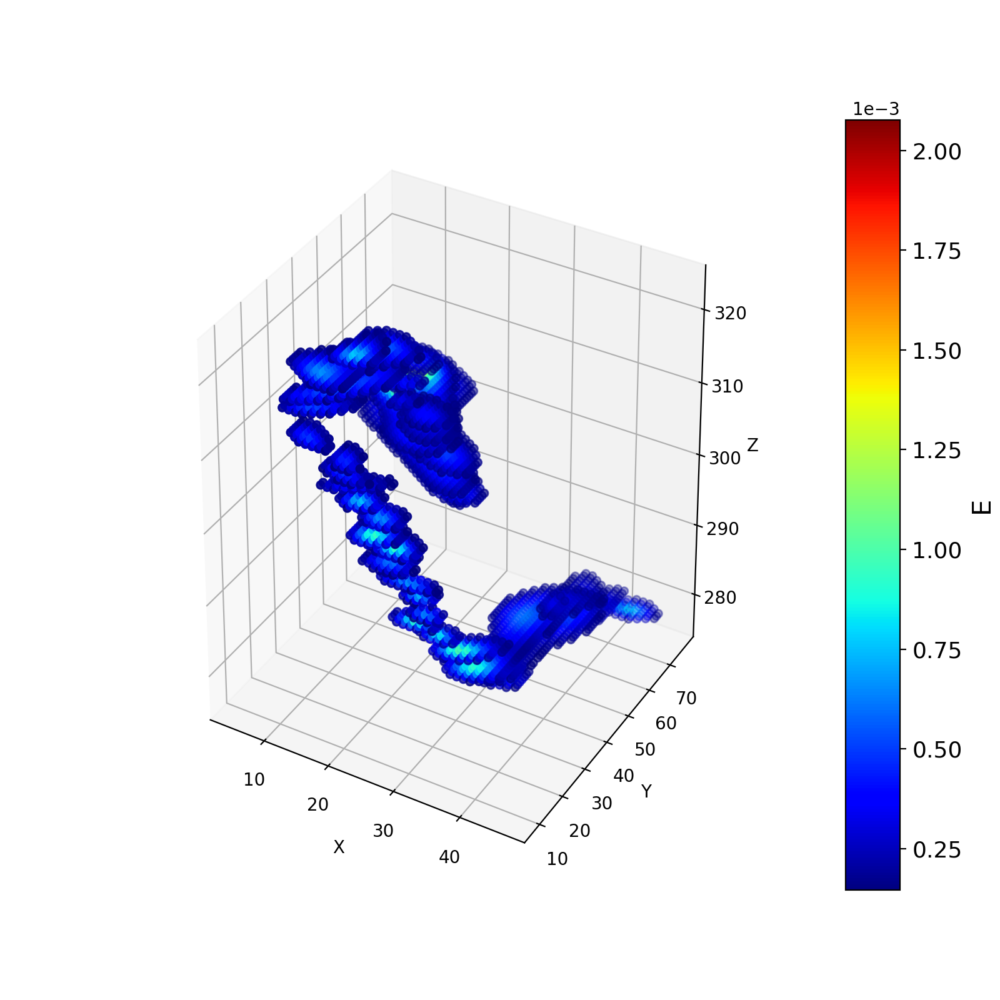

<IPython.core.display.Javascript object>


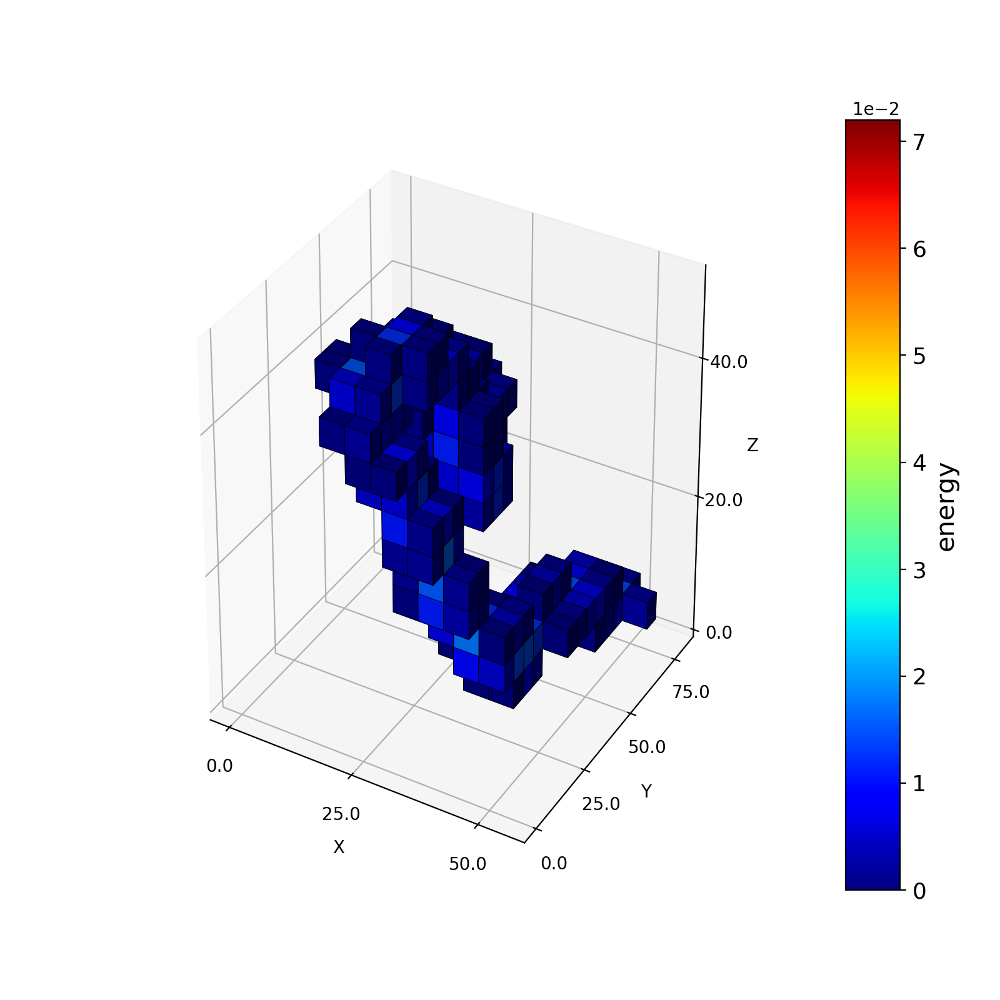

<IPython.core.display.Javascript object>


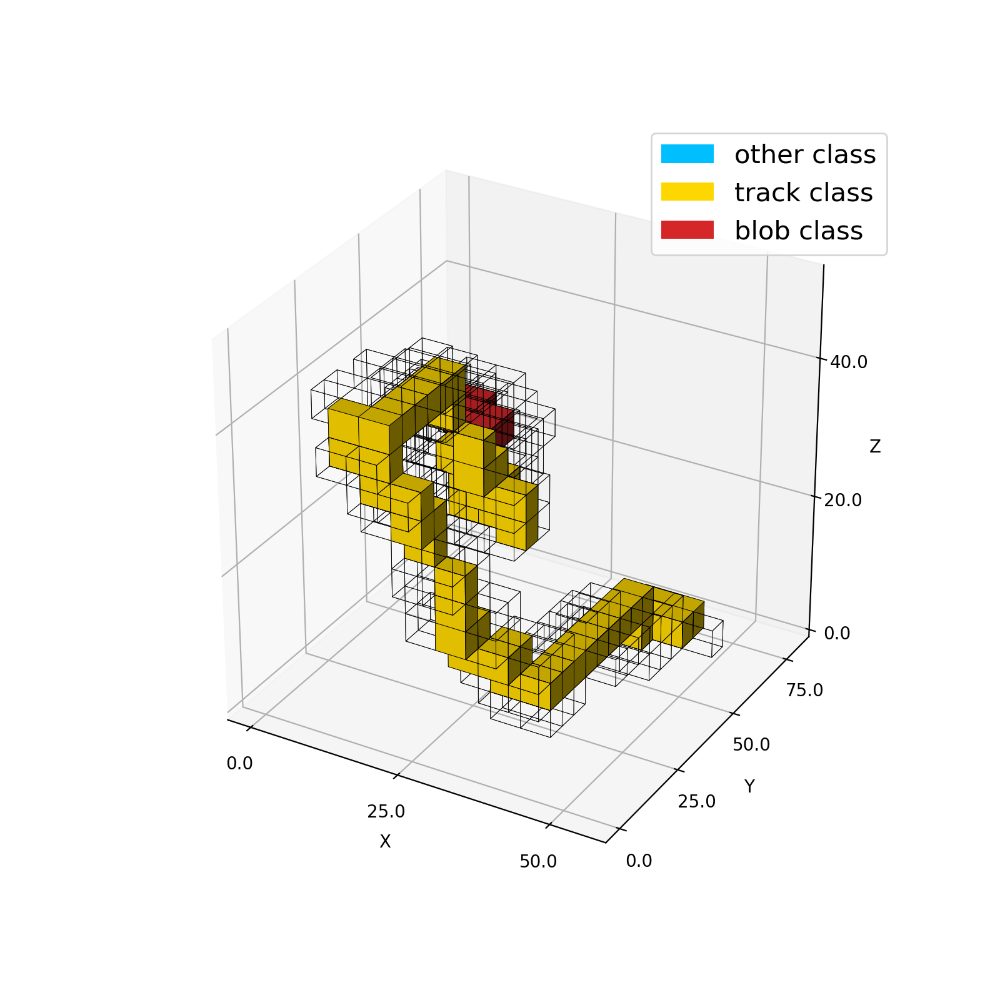

<IPython.core.display.Javascript object>


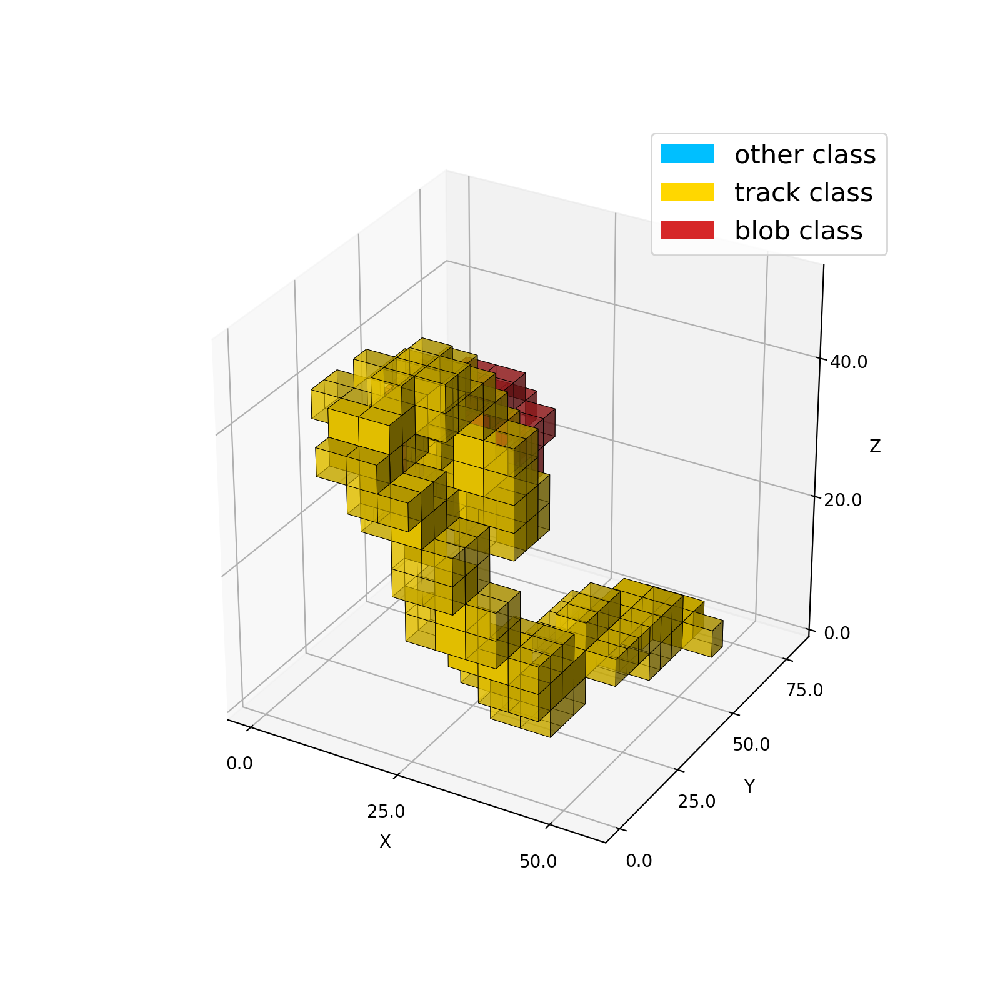

<IPython.core.display.Javascript object>


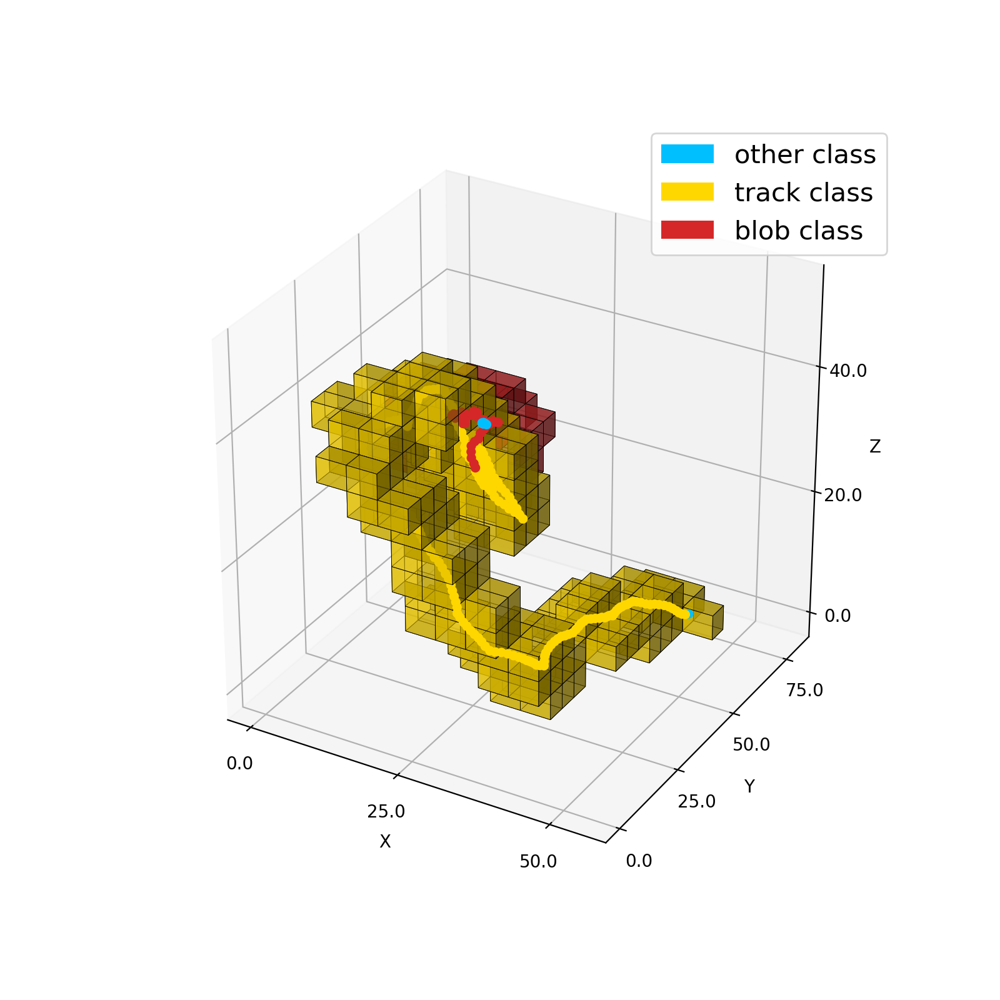




Show grouping event
EVENT 803


<IPython.core.display.Javascript object>


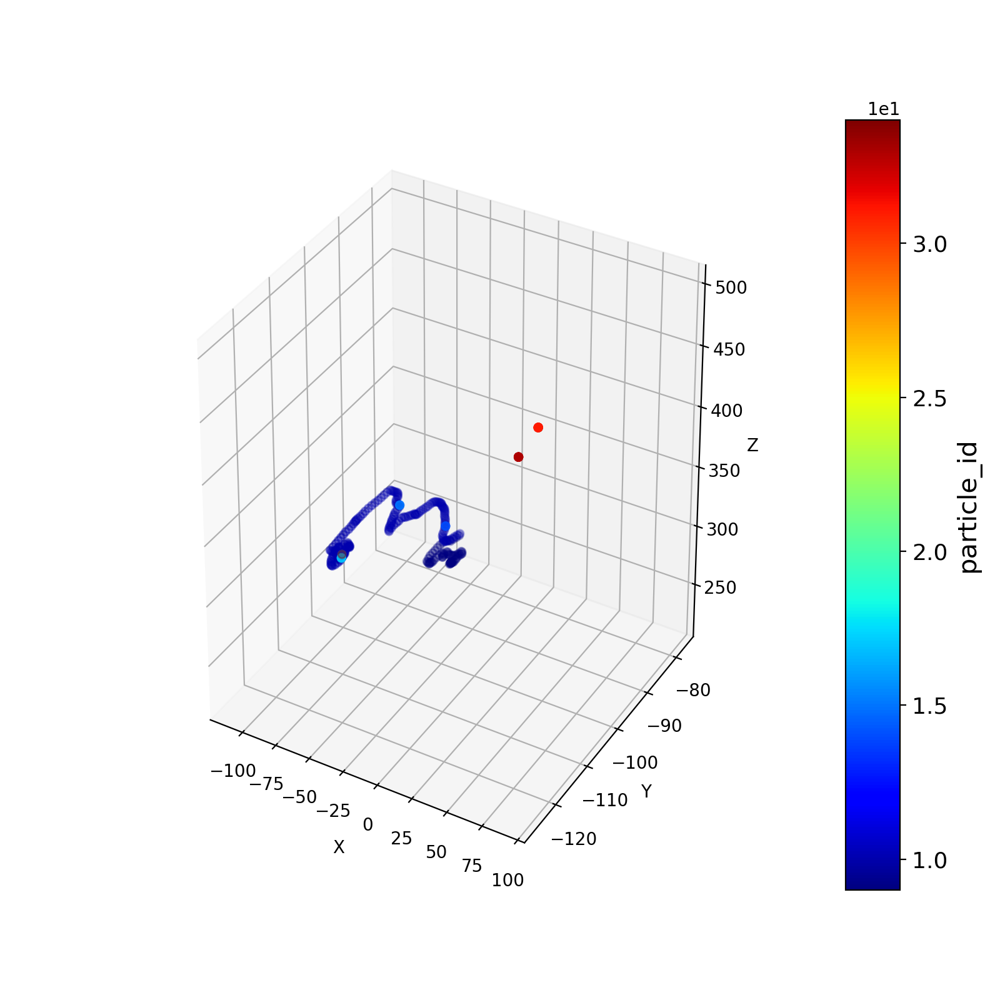

<IPython.core.display.Javascript object>


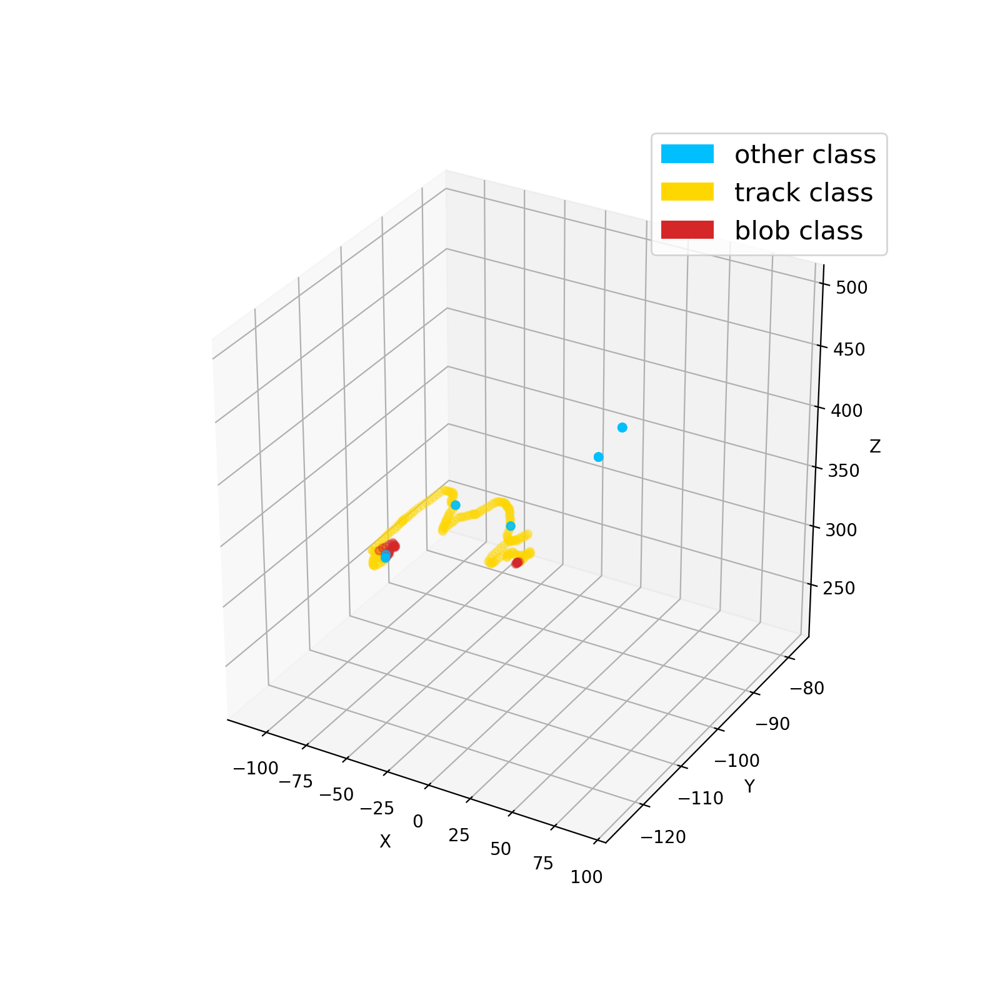

<IPython.core.display.Javascript object>


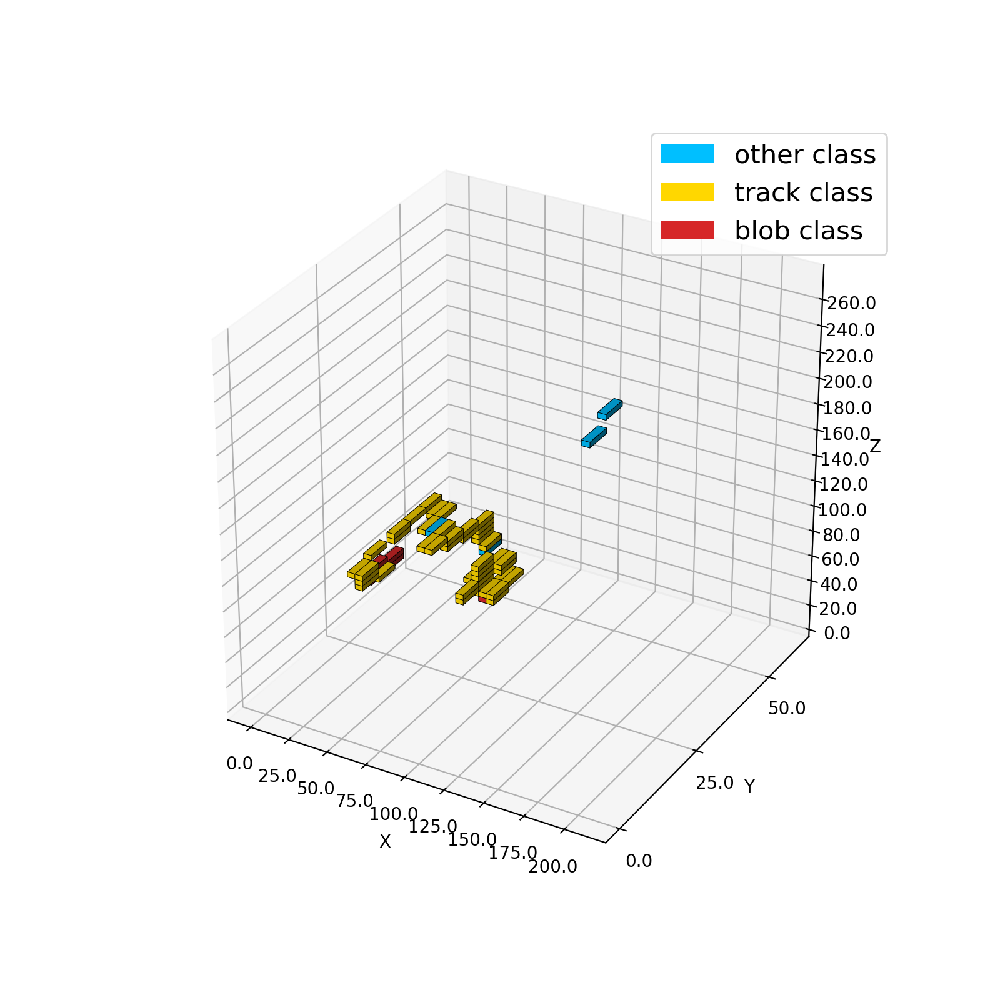

<IPython.core.display.Javascript object>


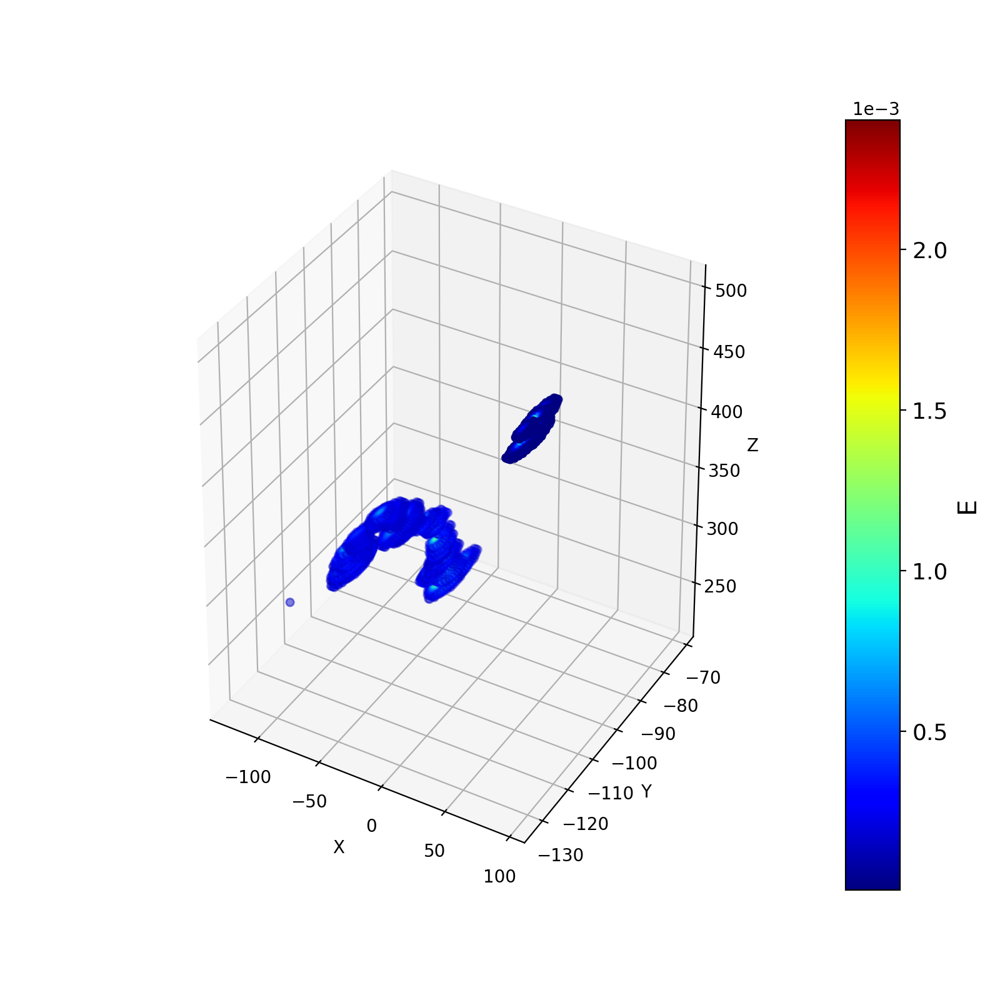

<IPython.core.display.Javascript object>


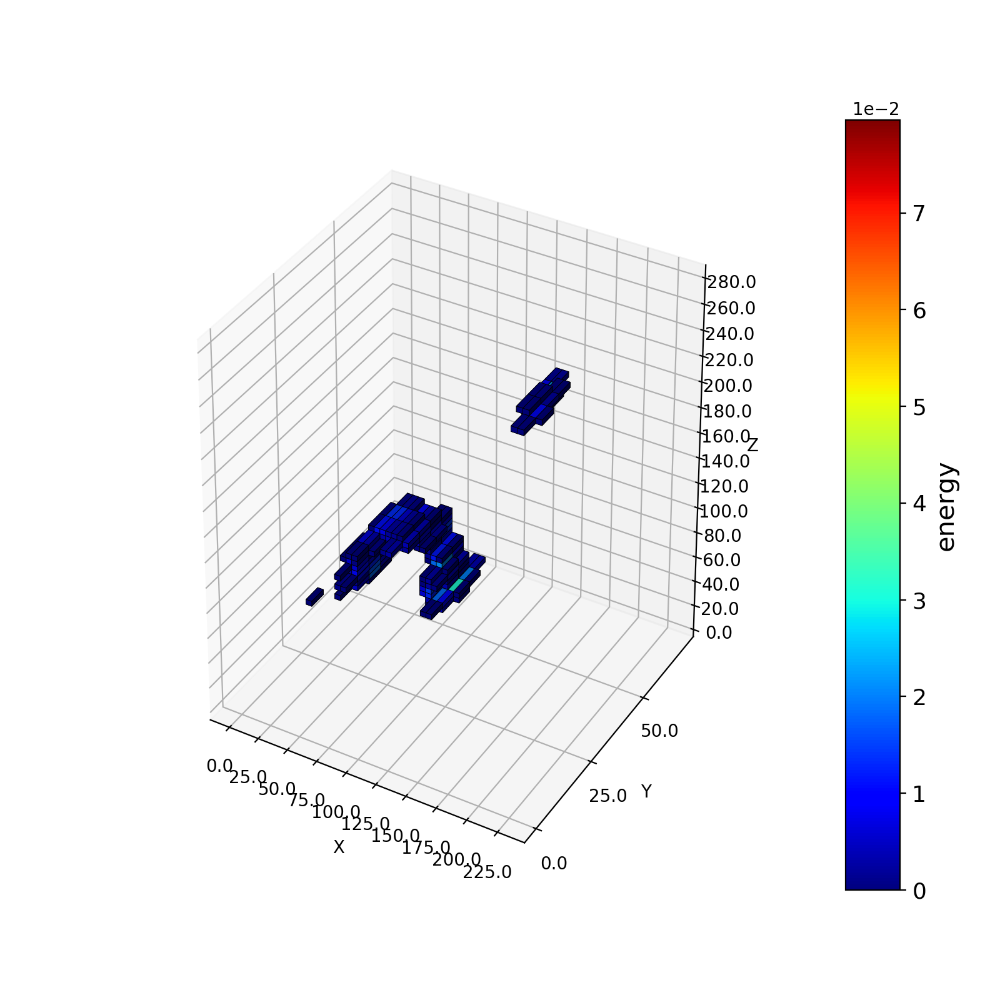

<IPython.core.display.Javascript object>


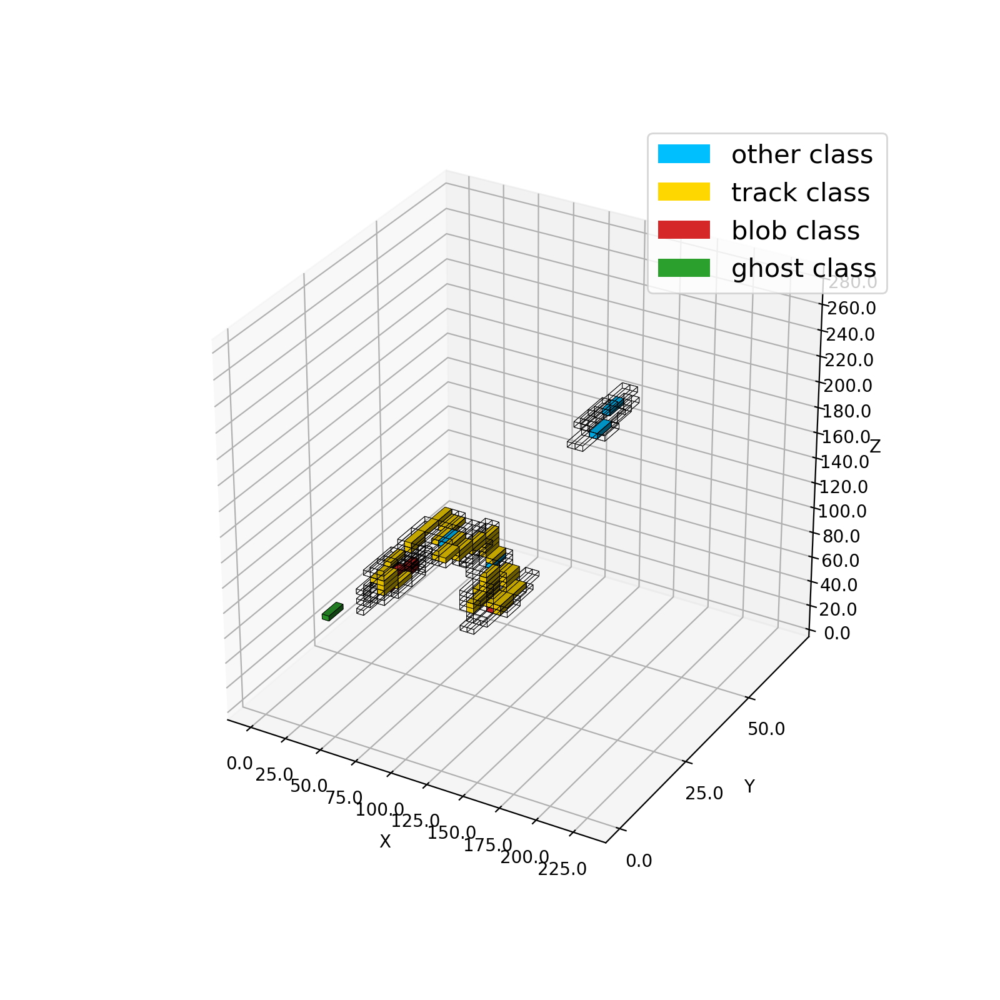

<IPython.core.display.Javascript object>


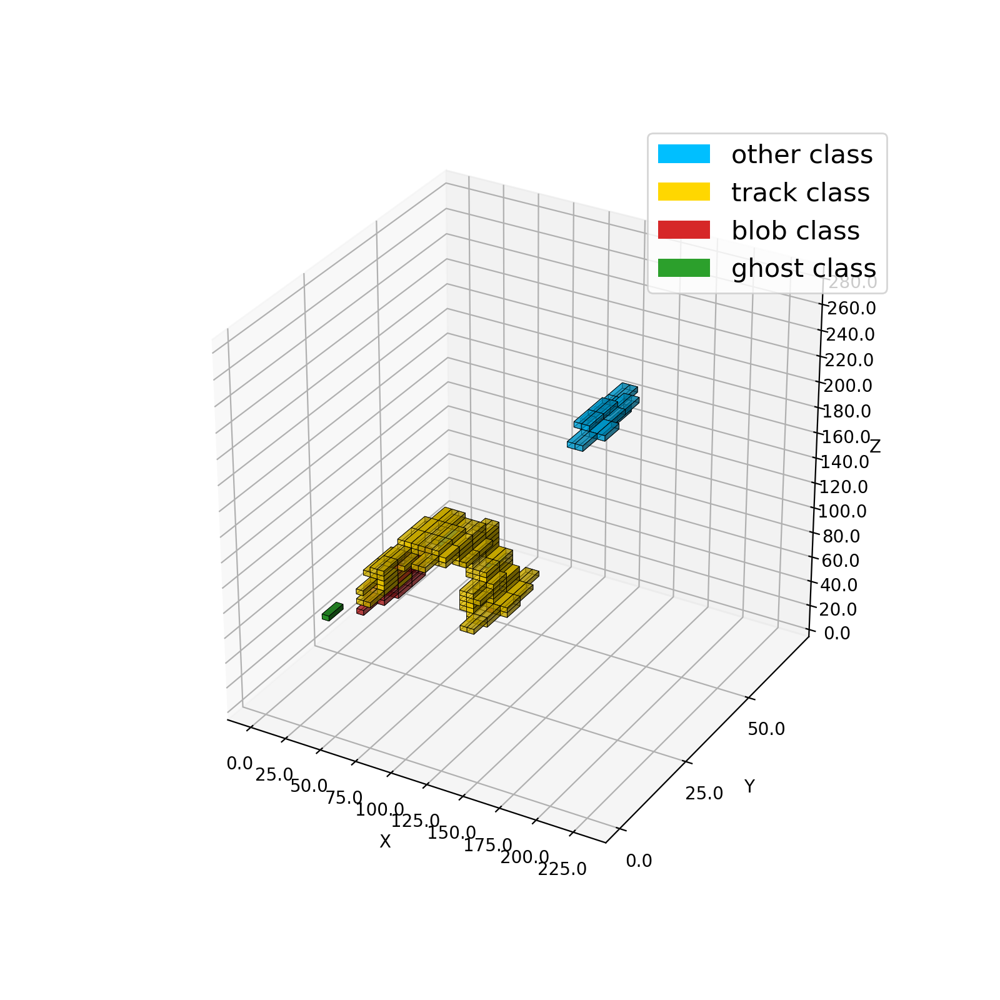

<IPython.core.display.Javascript object>


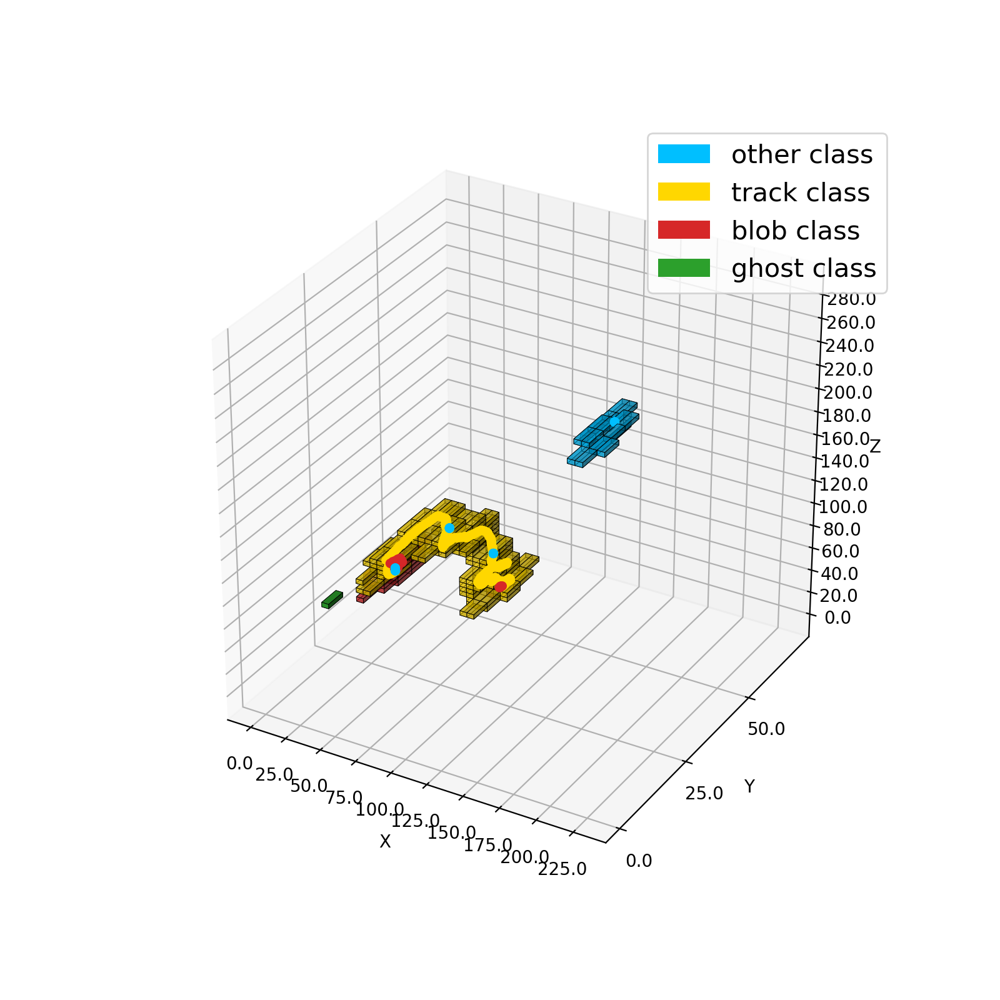




TRACK/BLOB IN SECONDARY CLOUDS

Reconstruction gap
EVENT 20


<IPython.core.display.Javascript object>


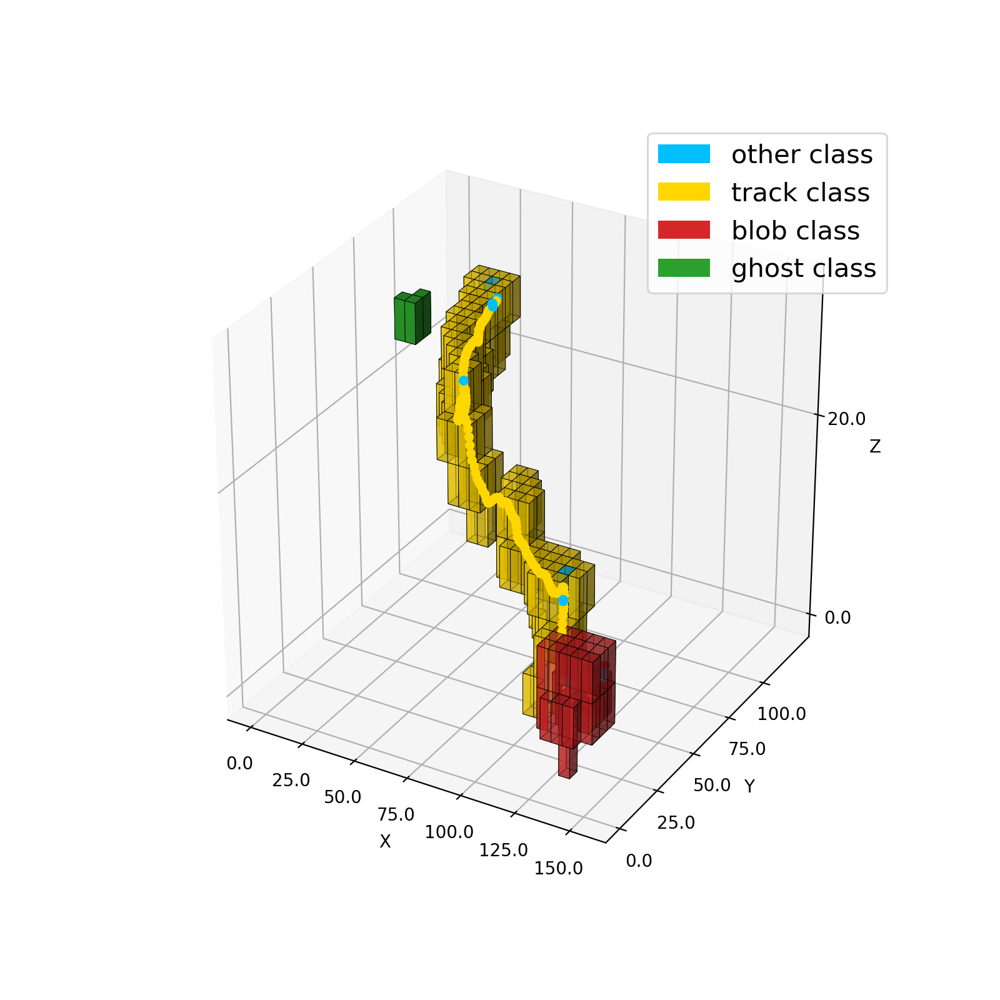




Energy ordering
EVENT 17121


<IPython.core.display.Javascript object>


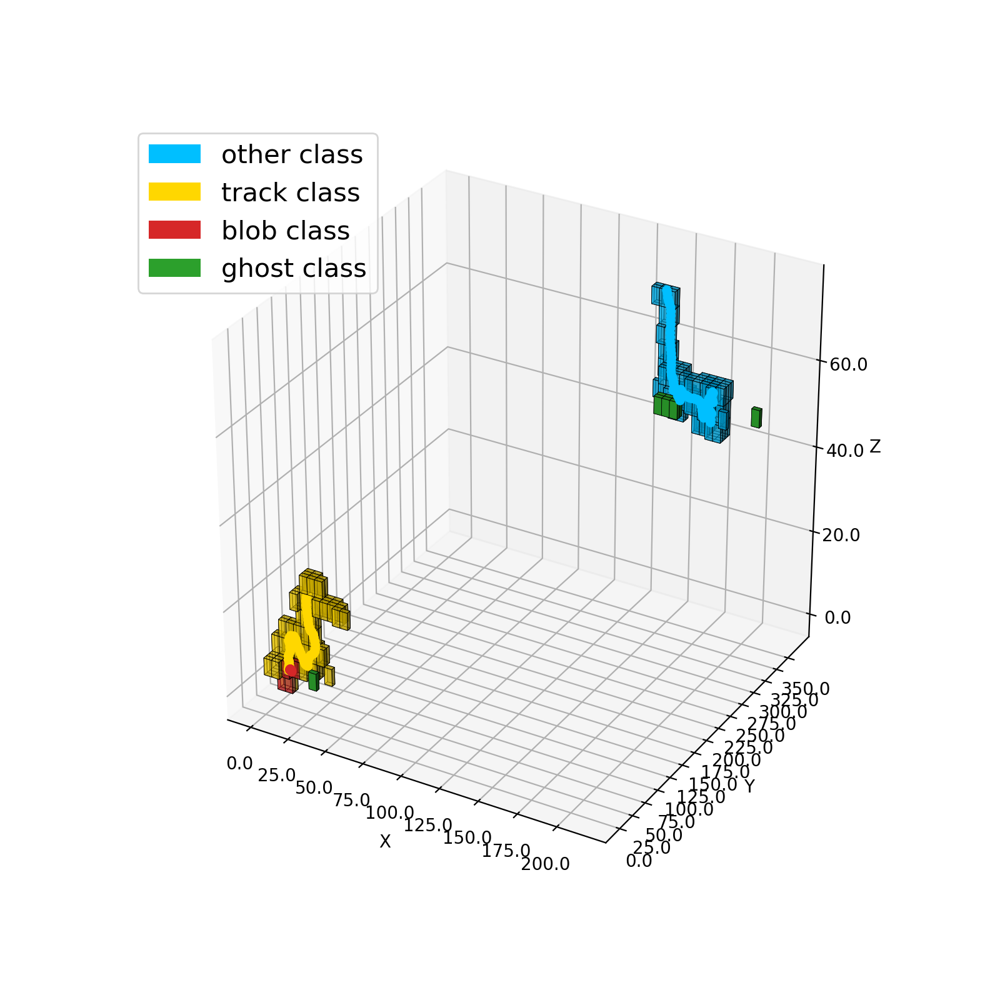




Event out of range
EVENT 20172


<IPython.core.display.Javascript object>


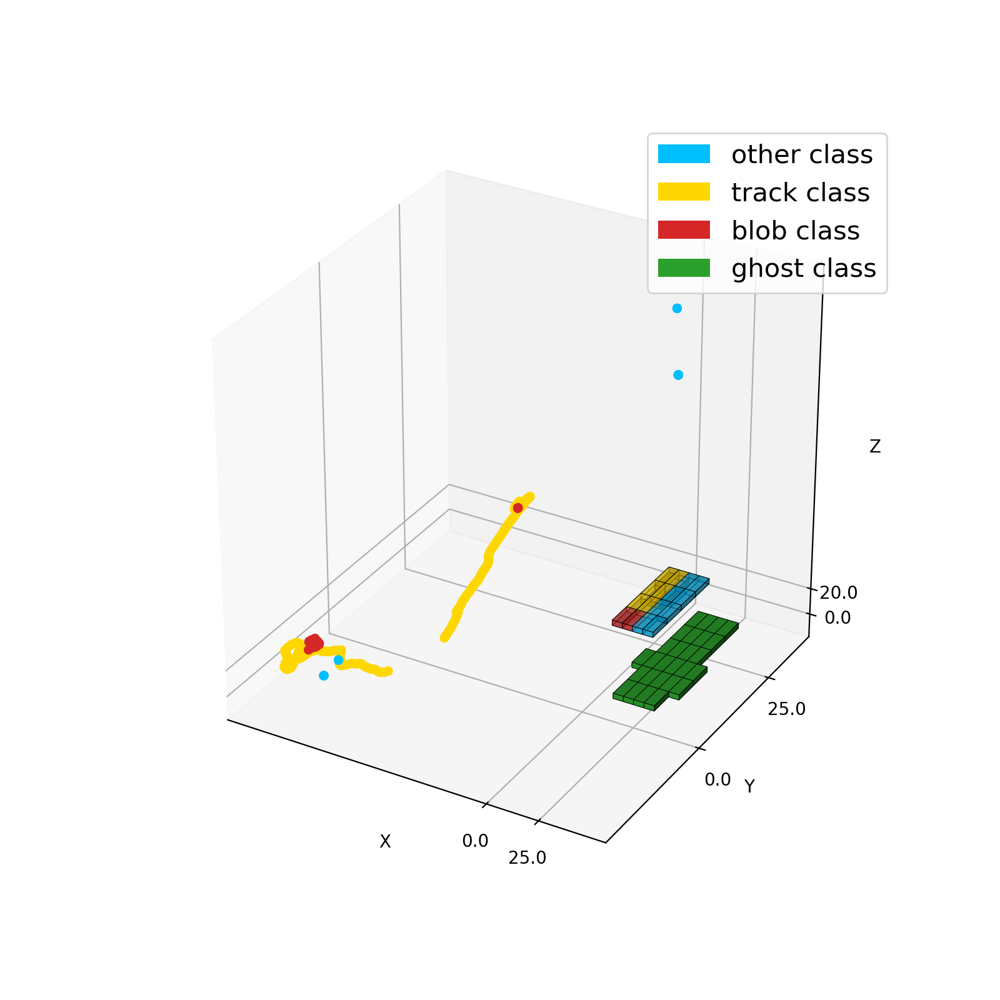




MORE THAN 1 TRACK ELEMENT

Interrupted by otherclass
EVENT 18


<IPython.core.display.Javascript object>


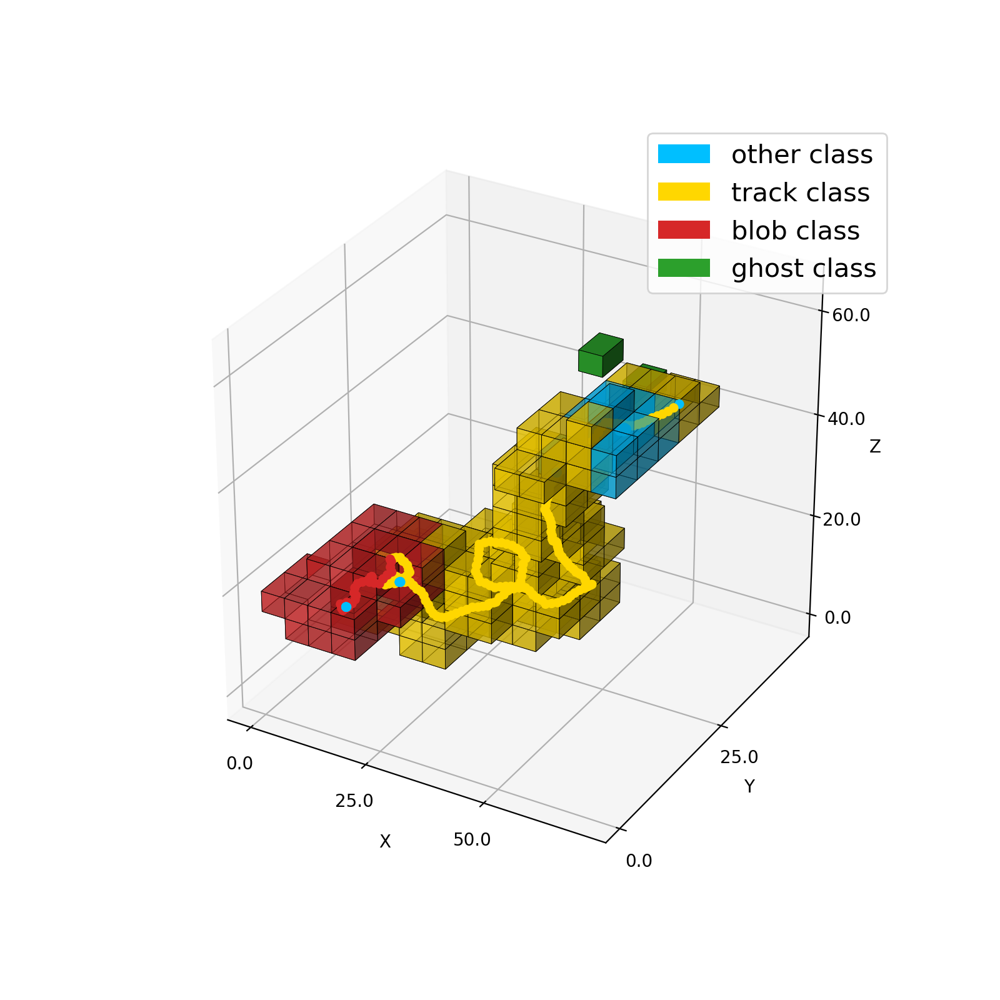




Twisted track
EVENT 10368


/Users/mperez/NEXT/data_labelling/utils/plotting_utils.py:754: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  ax  = plt.figure(figsize=(8, 8), frameon=False).add_subplot(projection='3d')


<IPython.core.display.Javascript object>


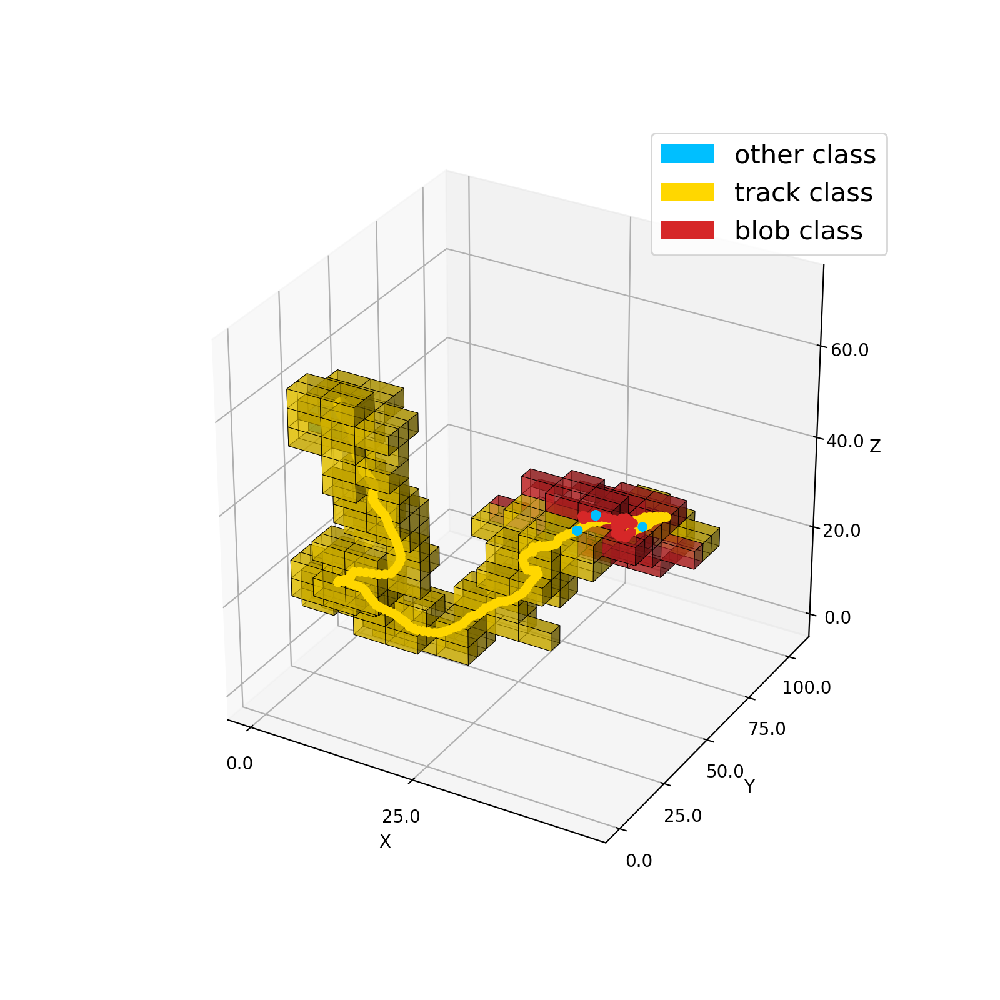




OTHER NUMBER OF BLOBS

Signal with 1 blob (twisted track)
EVENT 4961


<IPython.core.display.Javascript object>


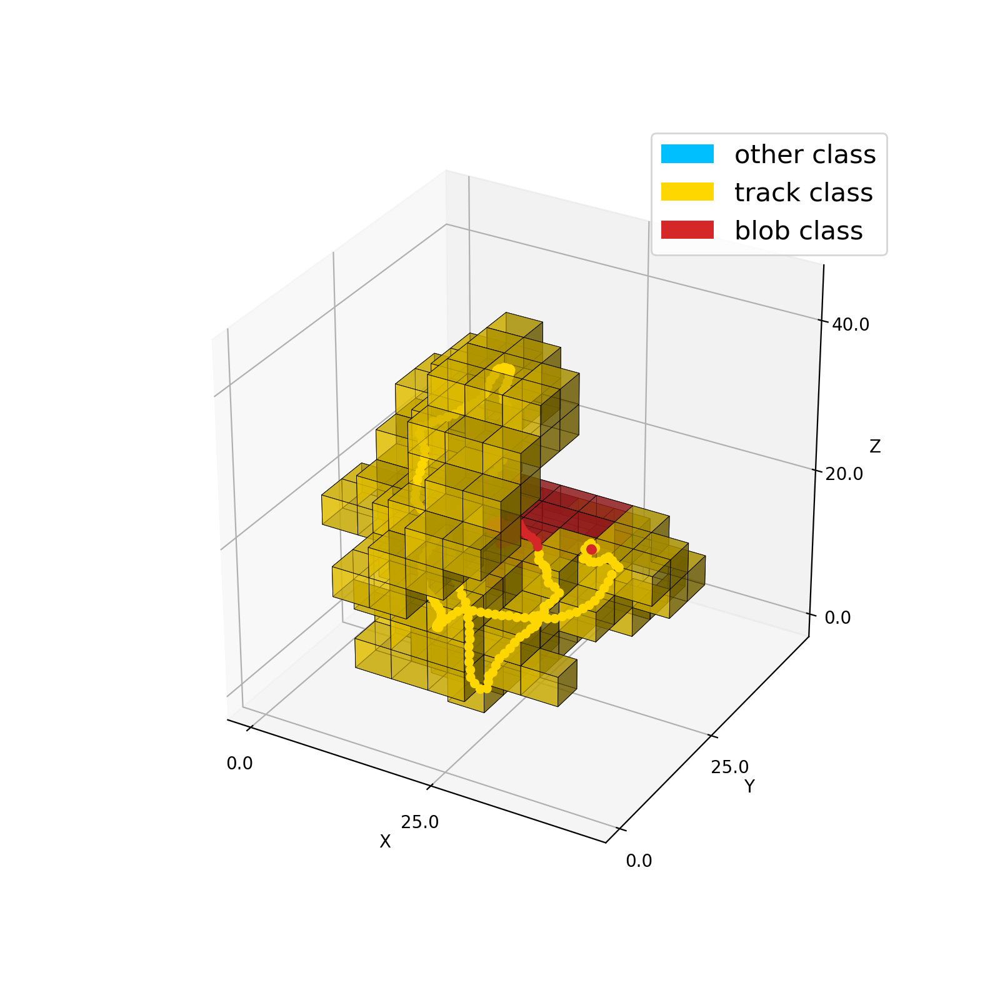




EXTREMES

Normal examples
EVENT 17


<IPython.core.display.Javascript object>


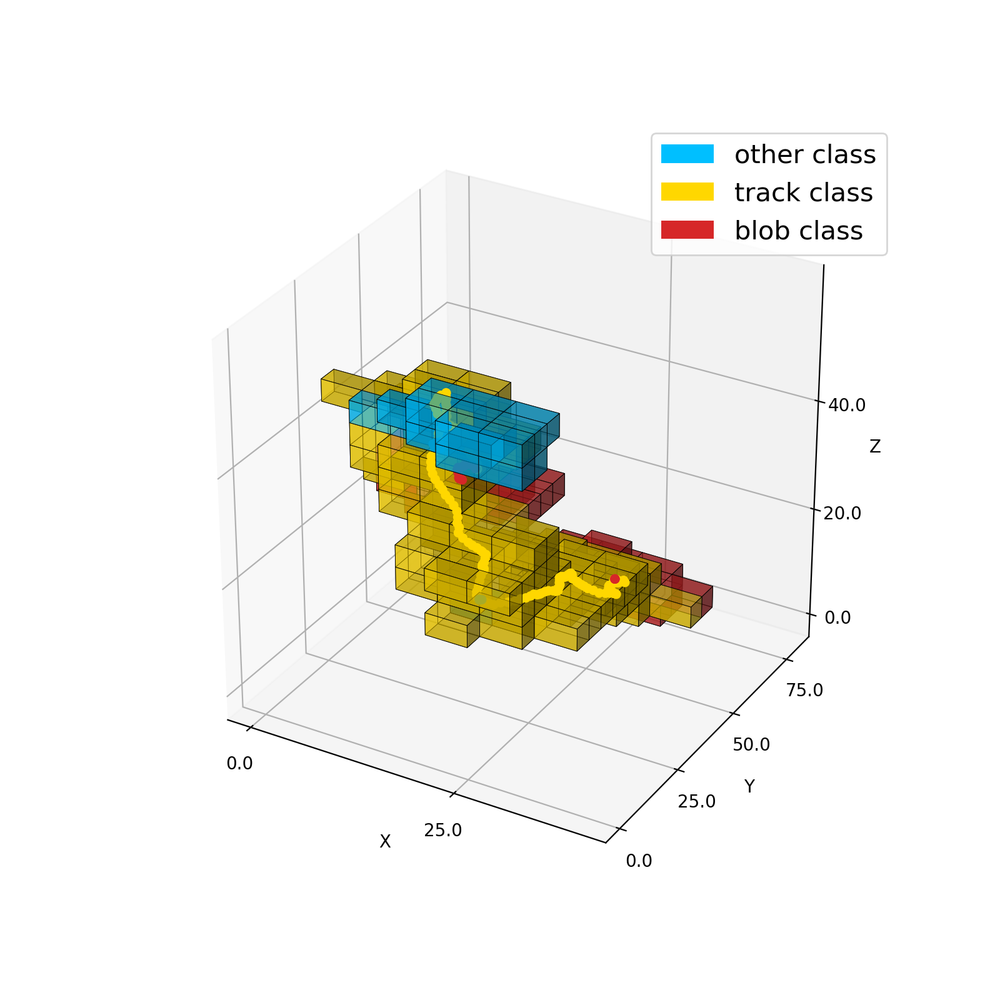

/Users/mperez/NEXT/data_labelling/utils/plotting_utils.py:878: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  ax  = plt.figure(figsize=(10, 10), frameon=False).add_subplot(projection='3d')


<IPython.core.display.Javascript object>


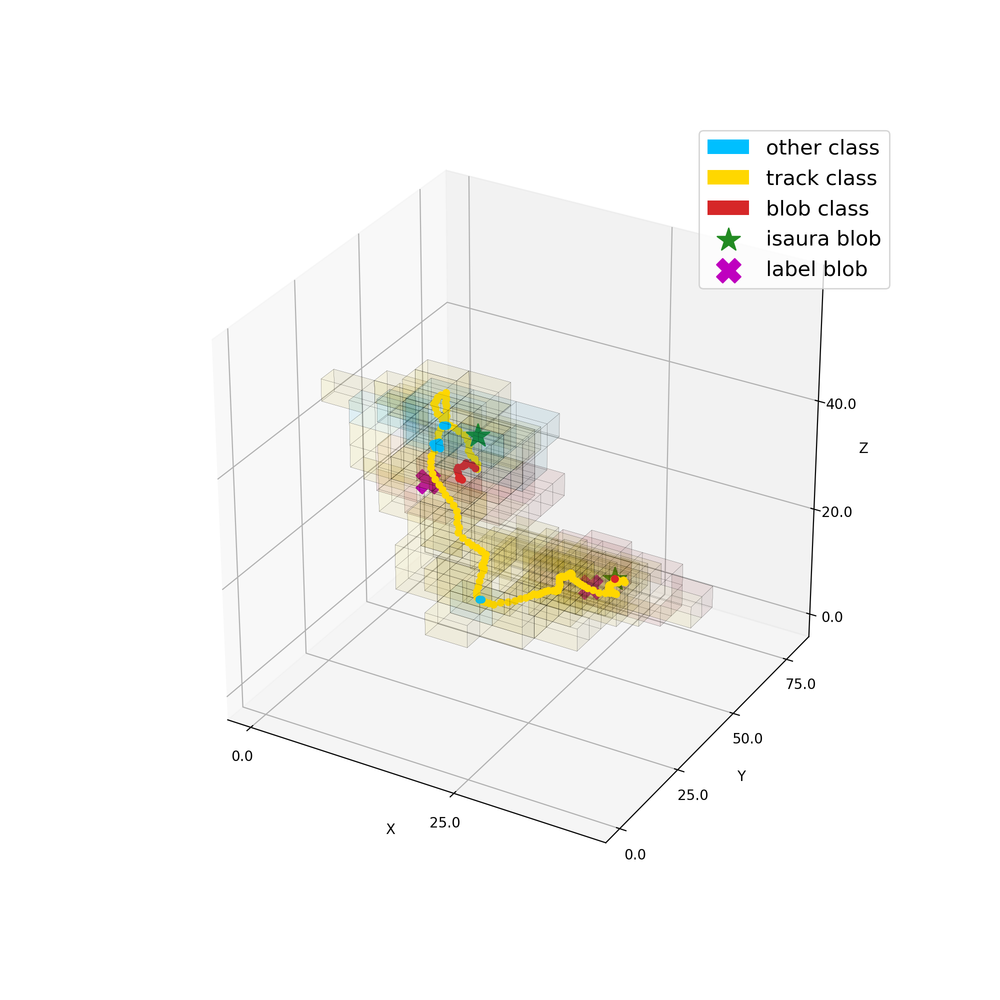




EVENT 138


<IPython.core.display.Javascript object>


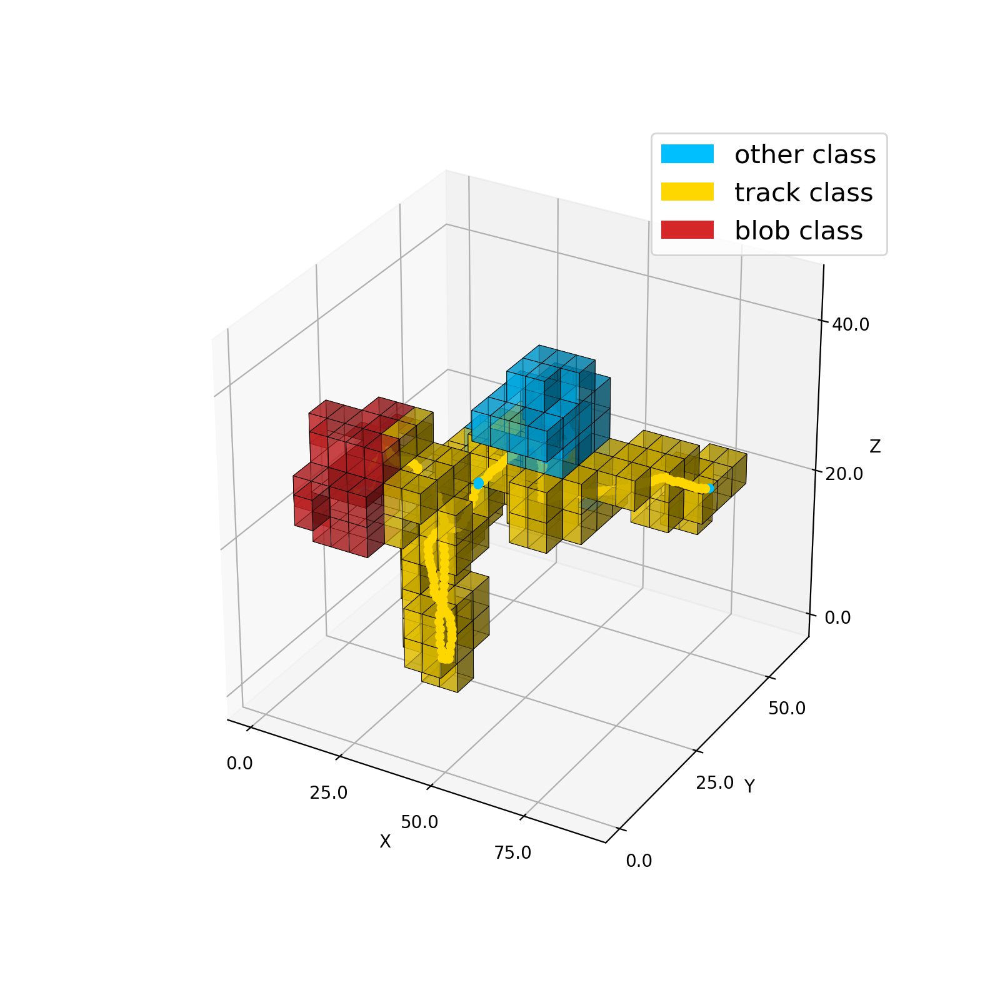

<IPython.core.display.Javascript object>


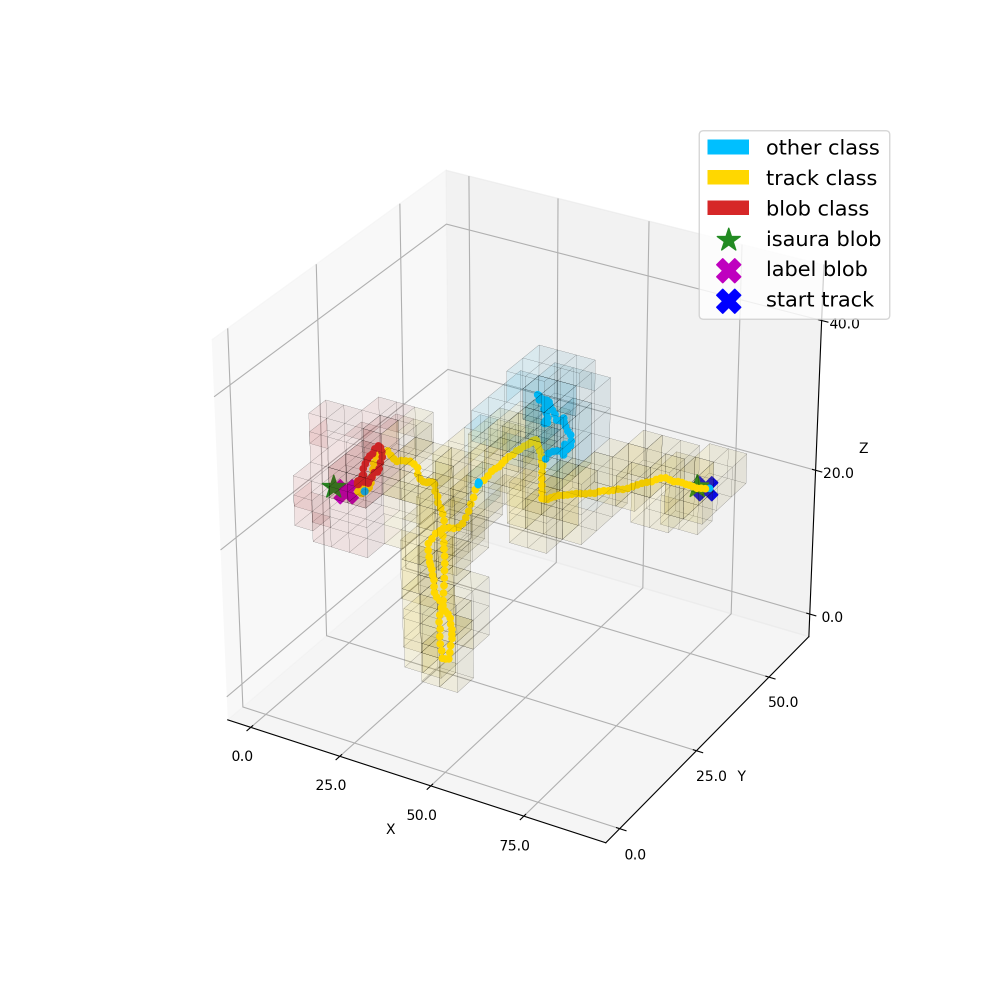




Signal with 1 blob
EVENT 4961


<IPython.core.display.Javascript object>


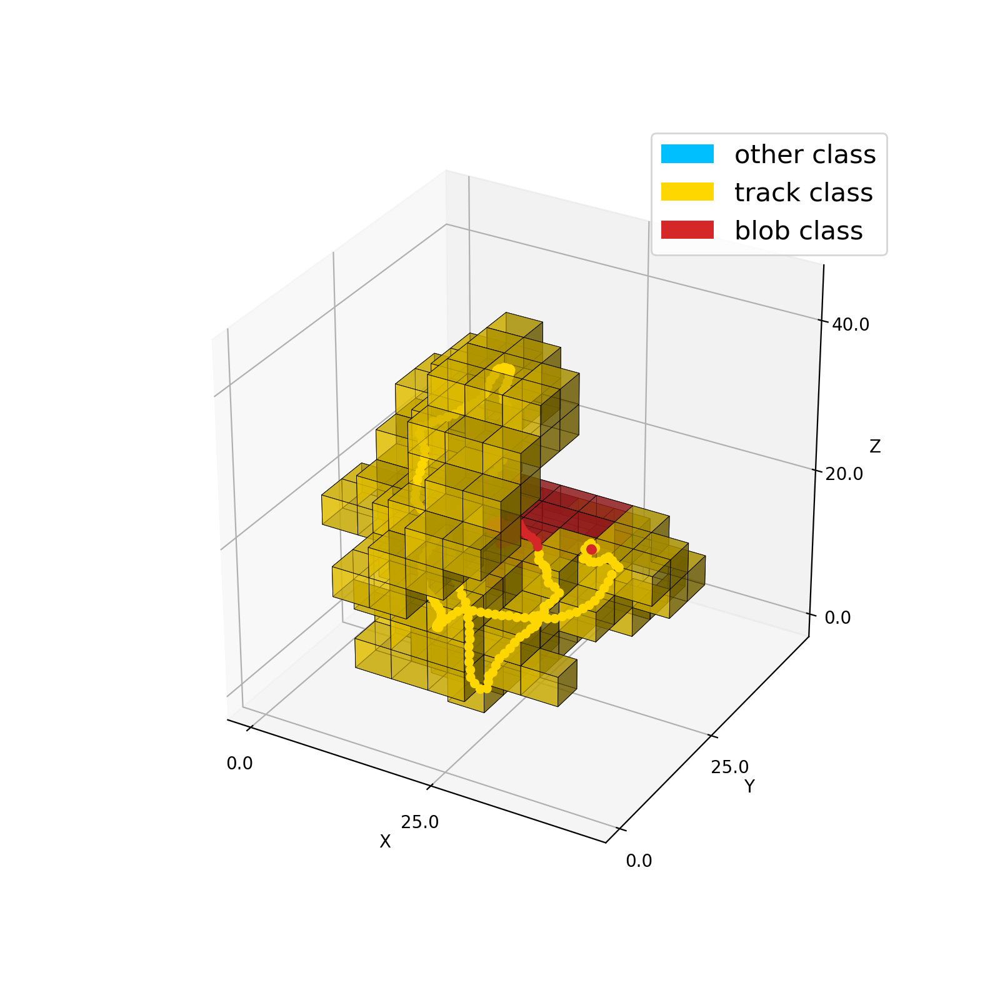

<IPython.core.display.Javascript object>


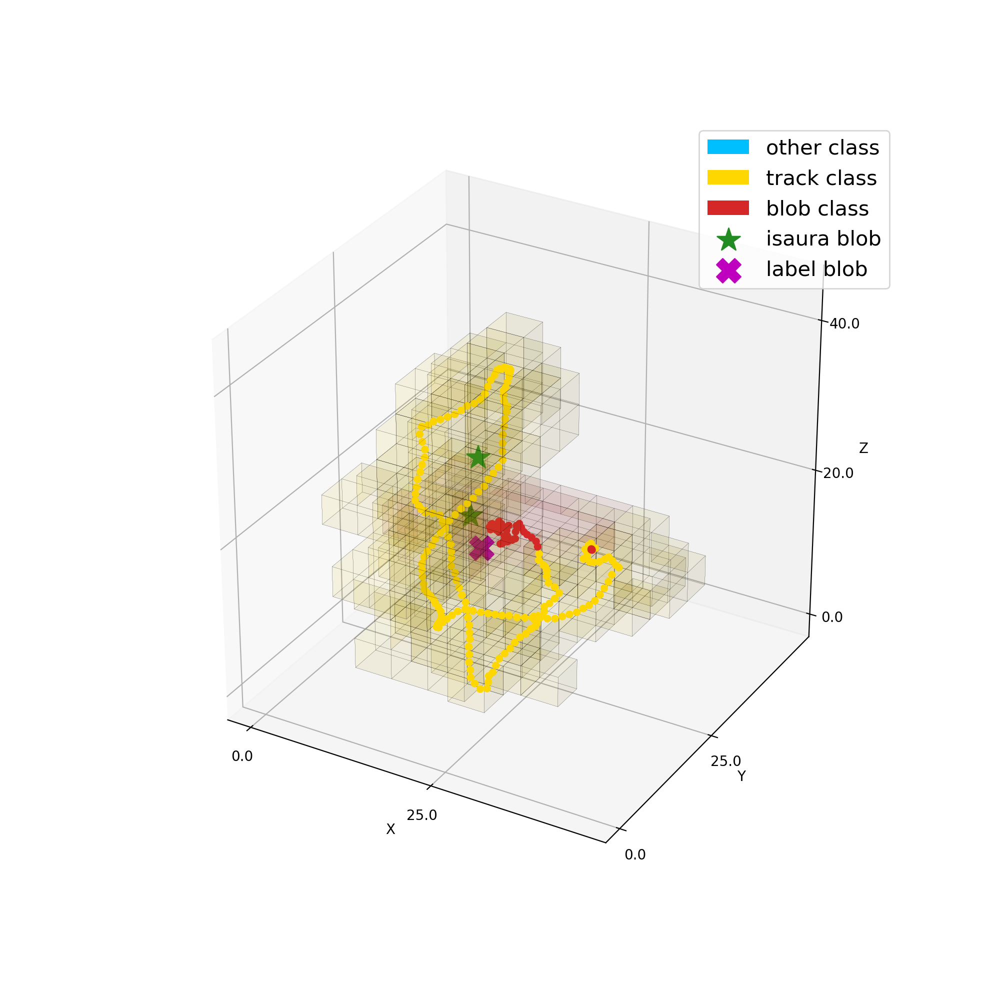




Background with 2 blobs
EVENT 25981


<IPython.core.display.Javascript object>


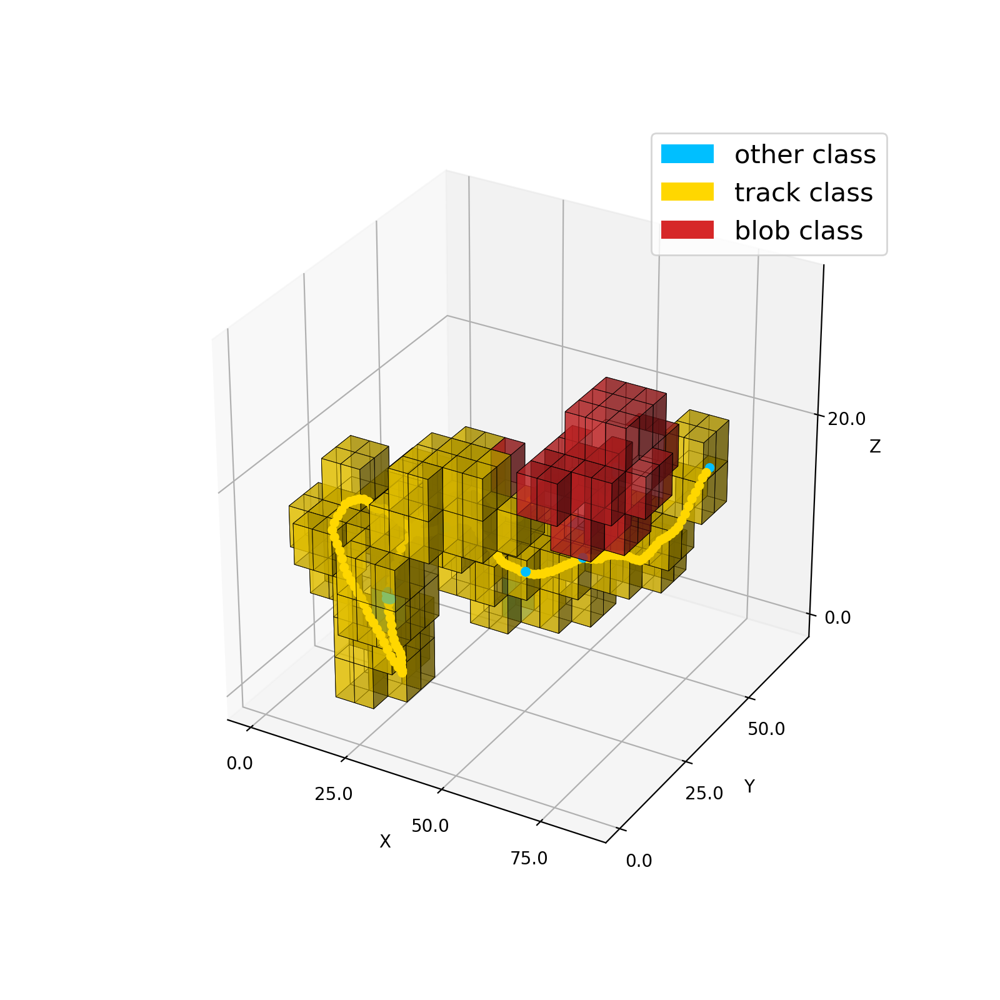

<IPython.core.display.Javascript object>


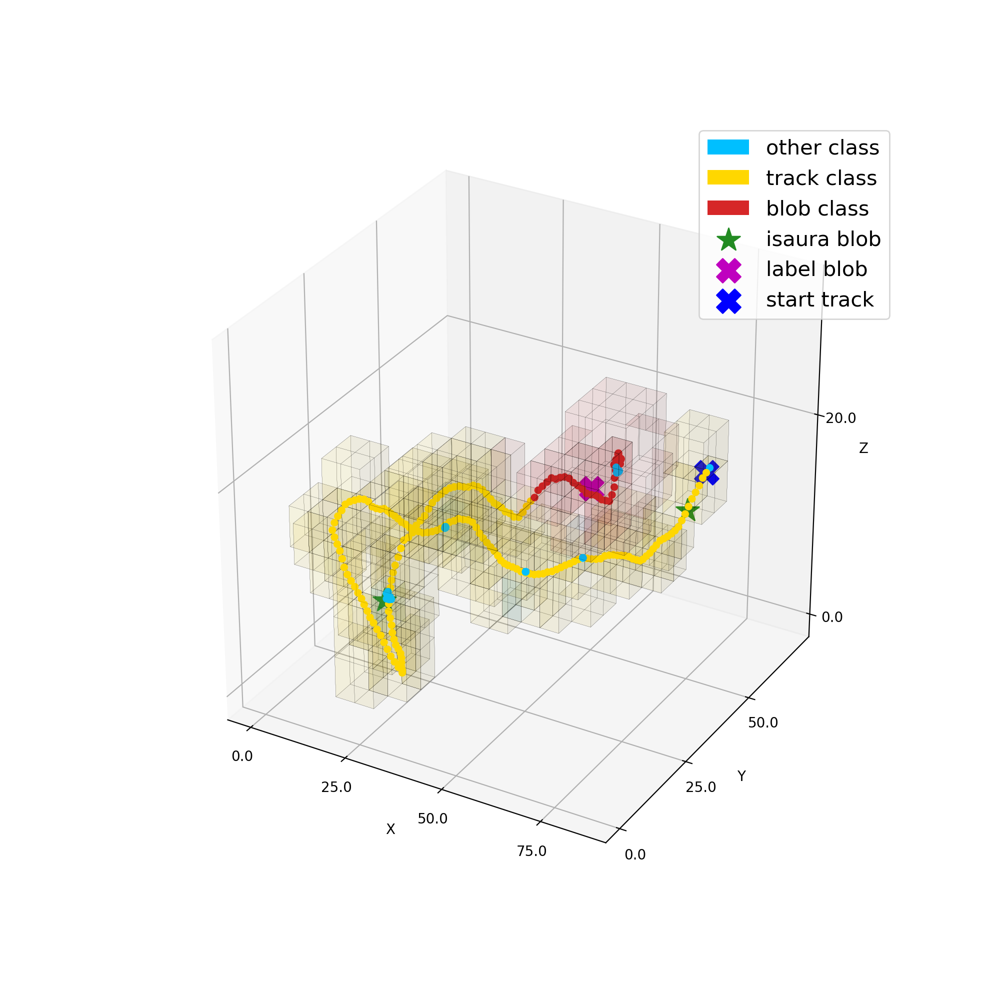

In [35]:
%matplotlib notebook

print('Show labelling event')
plot_full_event(80, MC_hits, beersheba_voxels, isaura_info_blobs, eventInfo, binsInfo, path, show_all = True)

print('Show grouping event')
plot_full_event(803, MC_hits, beersheba_voxels, isaura_info_blobs, eventInfo, binsInfo, path, show_all = True)

print('TRACK/BLOB IN SECONDARY CLOUDS')
print('')
print('Reconstruction gap')
plot_full_event(20, MC_hits, beersheba_voxels, isaura_info_blobs, eventInfo, binsInfo, path)
print('Energy ordering')
plot_full_event(17121, MC_hits, beersheba_voxels, isaura_info_blobs, eventInfo, binsInfo, path)
print('Event out of range')
plot_full_event(20172, MC_hits, beersheba_voxels, isaura_info_blobs, eventInfo, binsInfo, path)

print('MORE THAN 1 TRACK ELEMENT')
print('')
print('Interrupted by otherclass')
plot_full_event(18, MC_hits, beersheba_voxels, isaura_info_blobs, eventInfo, binsInfo, path)
print('Twisted track')
plot_full_event(10368, MC_hits, beersheba_voxels, isaura_info_blobs, eventInfo, binsInfo, path)


print('OTHER NUMBER OF BLOBS')
print('')
print('Signal with 1 blob (twisted track)')
plot_full_event(4961, MC_hits, beersheba_voxels, isaura_info_blobs, eventInfo, binsInfo, path)

print('EXTREMES')
print('')
print('Normal examples')
plot_full_event(17, MC_hits, beersheba_voxels, isaura_info_blobs, eventInfo, binsInfo, path, show_blobs=True)
plot_full_event(138, MC_hits, beersheba_voxels, isaura_info_blobs, eventInfo, binsInfo, path, show_blobs=True)

print('Signal with 1 blob')
plot_full_event(4961, MC_hits, beersheba_voxels, isaura_info_blobs, eventInfo, binsInfo, path, show_blobs=True)
print('Background with 2 blobs')
plot_full_event(25981, MC_hits, beersheba_voxels, isaura_info_blobs, eventInfo, binsInfo, path, show_blobs=True)


# Single event plot & information

In [41]:
nevent = 10000
ids = eventInfo.dataset_id.unique()
dataset_id = ids[nevent]


event_MC_hits = MC_hits[MC_hits.dataset_id == dataset_id]
event_beersh_vox = beersheba_voxels[beersheba_voxels.dataset_id == dataset_id]

In [17]:
creators = []
for basename in eventInfo.basename.unique():
    original_file = path + basename
    MC_particles = dio.load_dst(original_file, 'MC', 'particles')
    creators.append(MC_particles.creator_proc.unique())

In [21]:
for cr in creators:
    

array(['none', 'RadioactiveDecay', 'phot', 'compt', 'eIoni', 'eBrem',
       'conv', 'annihil'], dtype=object)

In [22]:
creators

[array(['none', 'RadioactiveDecay', 'phot', 'compt', 'eIoni', 'eBrem',
        'conv', 'annihil'], dtype=object),
 array(['none', 'RadioactiveDecay', 'conv', 'eIoni', 'phot', 'compt',
        'annihil', 'eBrem'], dtype=object),
 array(['none', 'RadioactiveDecay', 'conv', 'phot', 'compt', 'annihil',
        'eBrem', 'eIoni'], dtype=object),
 array(['none', 'RadioactiveDecay', 'conv', 'eIoni', 'eBrem', 'phot',
        'compt', 'annihil'], dtype=object),
 array(['none', 'RadioactiveDecay', 'phot', 'compt', 'eIoni', 'eBrem',
        'conv', 'annihil'], dtype=object),
 array(['none', 'RadioactiveDecay', 'phot', 'compt', 'eIoni', 'eBrem',
        'conv', 'annihil'], dtype=object),
 array(['none', 'RadioactiveDecay', 'phot', 'compt', 'eIoni', 'eBrem',
        'conv', 'annihil'], dtype=object),
 array(['none', 'RadioactiveDecay', 'phot', 'compt', 'eIoni', 'eBrem',
        'conv', 'annihil'], dtype=object),
 array(['none', 'RadioactiveDecay', 'conv', 'phot', 'compt', 'eIoni',
        'annihil',

In [42]:
basename = eventInfo[eventInfo.dataset_id == dataset_id].basename.item()
original_file =  path + basename

In [43]:
label_original_file = path + eventInfo[eventInfo.dataset_id == dataset_id].label_basename.item()

In [44]:
event_id_bersh = eventInfo[eventInfo.dataset_id == dataset_id].event_id.item()

In [45]:
beersheba_hits = dio.load_dst(original_file, 'DECO', 'Events')

In [46]:
event_beersh_hits = beersheba_hits[beersheba_hits.event == event_id_bersh]

In [47]:
MC_particles = dio.load_dst(original_file, 'MC', 'particles')

In [48]:
MC_particles.particle_name.unique()

array(['Tl208', 'e-', 'anti_nu_e', 'Pb208[3197.711]', 'Pb208[2614.522]',
       'Pb208', 'gamma', 'e+', 'Pb208[3475.078]', 'Pb208[3708.451]',
       'Pb208[3919.966]', 'Pb208[3961.162]', 'Pb208[4180.414]',
       'Pb208[4125.347]'], dtype=object)

In [49]:
MC_particles.creator_proc.unique()

array(['none', 'RadioactiveDecay', 'conv', 'phot', 'compt', 'eIoni',
       'annihil', 'eBrem'], dtype=object)

In [14]:
event_MC_particles = MC_particles[MC_particles.event_id == event_id_bersh]

In [15]:
MC_voxels = dio.load_dst(label_original_file, 'DATASET', 'MCVoxels')

In [16]:
label_eventInfo = dio.load_dst(label_original_file, 'DATASET', 'EventsInfo')

In [17]:
label_event_id = label_eventInfo[(label_eventInfo.event_id == event_id_bersh) & (label_eventInfo.basename == basename)].dataset_id.item()


In [18]:
event_MC_voxels = MC_voxels[MC_voxels.dataset_id == label_event_id]

In [19]:
shown_particles = event_MC_particles[np.isin(event_MC_particles.particle_id, event_MC_hits.particle_id.unique())]

In [20]:
shown_particles = shown_particles.merge(event_MC_hits[['particle_id', 'segclass']].drop_duplicates(), on = 'particle_id', how = 'outer')

In [27]:
pd.set_option('display.max_columns', 30)
shown_particles

,event_id,particle_id,particle_name,primary,mother_id,initial_x,initial_y,initial_z,initial_t,final_x,final_y,final_z,final_t,initial_volume,final_volume,initial_momentum_x,initial_momentum_y,initial_momentum_z,kin_energy,creator_proc,final_momentum_x,final_momentum_y,final_momentum_z,length,final_proc,segclass
0,10000086,8,gamma,False,5,-2.496404,316.075714,275.058868,5.704462e+11,249.879974,-106.781555,139.191025,5.704462e+11,SCREW_SOURCE,ICS,0.492635,-2.567613,0.017583,2.614504,RadioactiveDecay,NaN,NaN,NaN,NaN,NaN,1.0
1,10000086,9,e-,False,8,43.242004,77.687050,276.691406,5.704462e+11,11.454272,59.824017,305.196136,5.704462e+11,ACTIVE,ACTIVE,-0.215282,-1.889662,0.488527,1.518027,compt,NaN,NaN,NaN,NaN,NaN,2.0
2,10000086,9,e-,False,8,43.242004,77.687050,276.691406,5.704462e+11,11.454272,59.824017,305.196136,5.704462e+11,ACTIVE,ACTIVE,-0.215282,-1.889662,0.488527,1.518027,compt,NaN,NaN,NaN,NaN,NaN,3.0
3,10000086,18,e-,False,9,15.852752,59.189632,306.528900,5.704462e+11,14.757421,59.693523,306.140900,5.704462e+11,ACTIVE,ACTIVE,-0.193796,0.198135,-0.221468,0.111080,eIoni,NaN,NaN,NaN,NaN,NaN,1.0


In [28]:
event_MC_hits[event_MC_hits.particle_id == 8]

,x,y,z,hit_id,particle_id,energy,segclass,binclass,dist_hits,cumdist,particle_name,creator_proc,group_ener,small_b,dataset_id
19946,43.242004,77.68705,276.691406,0,8,0.000691,1.0,0,0.0,0.0,gamma,RadioactiveDecay,0.000691,False,80


In [31]:
event_MC_hits[event_MC_hits.particle_id == 8]

,x,y,z,hit_id,particle_id,energy,segclass,binclass,dist_hits,cumdist,particle_name,creator_proc,group_ener,small_b,dataset_id
19946,43.242004,77.68705,276.691406,0,8,0.000691,1.0,0,0.0,0.0,gamma,RadioactiveDecay,0.000691,False,80


In [30]:
event_MC_particles[event_MC_particles.mother_id == 8]

,event_id,particle_id,particle_name,primary,mother_id,initial_x,initial_y,initial_z,initial_t,final_x,final_y,final_z,final_t,initial_volume,final_volume,initial_momentum_x,initial_momentum_y,initial_momentum_z,kin_energy,creator_proc,final_momentum_x,final_momentum_y,final_momentum_z,length,final_proc
2509,10000086,12,e-,False,8,249.879974,-106.781555,139.191025,5.704462e+11,249.882767,-106.762718,139.192352,5.704462e+11,ICS,ICS,0.079105,0.542581,0.037009,0.239428,phot,NaN,NaN,NaN,NaN,NaN
2510,10000086,11,e-,False,8,254.068771,-120.844368,139.116989,5.704462e+11,254.068802,-120.844368,139.116959,5.704462e+11,ICS,ICS,0.034411,0.002706,-0.067430,0.005584,compt,NaN,NaN,NaN,NaN,NaN
2511,10000086,10,e-,False,8,255.405502,-129.919708,141.543152,5.704462e+11,255.476212,-130.067352,141.492798,5.704462e+11,ICS,ICS,0.735055,-0.943566,-0.371698,0.841740,compt,NaN,NaN,NaN,NaN,NaN
2512,10000086,9,e-,False,8,43.242004,77.687050,276.691406,5.704462e+11,11.454272,59.824017,305.196136,5.704462e+11,ACTIVE,ACTIVE,-0.215282,-1.889662,0.488527,1.518027,compt,NaN,NaN,NaN,NaN,NaN


In [155]:
event_MC_particles

,event_id,particle_id,particle_name,primary,mother_id,initial_x,initial_y,initial_z,initial_t,final_x,final_y,final_z,final_t,initial_volume,final_volume,initial_momentum_x,initial_momentum_y,initial_momentum_z,kin_energy,creator_proc,final_momentum_x,final_momentum_y,final_momentum_z,length,final_proc
15122,110000561,1,Tl208,True,0,0.441205,315.896484,274.693268,0.000000e+00,0.441205,315.896484,274.693268,1.522213e+11,SCREW_SOURCE,SCREW_SOURCE,0.000000,0.000000,0.000000,0.000000e+00,none,NaN,NaN,NaN,NaN,NaN
15123,110000561,4,e-,False,1,0.441205,315.896484,274.693268,1.522213e+11,-1.168858,315.741791,275.507080,1.522213e+11,SCREW_SOURCE,SCREW_SOURCE,-0.337006,-0.481636,0.736963,5.612789e-01,RadioactiveDecay,NaN,NaN,NaN,NaN,NaN
15124,110000561,3,anti_nu_e,False,1,0.441205,315.896484,274.693268,1.522213e+11,-12500.000000,1053.953003,-9329.493164,1.522213e+11,SCREW_SOURCE,WORLD,-0.577565,0.034101,-0.443747,7.291473e-01,RadioactiveDecay,NaN,NaN,NaN,NaN,NaN
15125,110000561,2,Pb208[3708.451],False,1,0.441205,315.896484,274.693268,1.522213e+11,0.441206,315.896484,274.693268,1.522213e+11,SCREW_SOURCE,SCREW_SOURCE,0.914573,0.447536,-0.293216,2.898218e-06,RadioactiveDecay,NaN,NaN,NaN,NaN,NaN
15126,110000561,5,Pb208[3197.711],False,2,0.441206,315.896484,274.693268,1.522213e+11,0.441206,315.896484,274.693268,1.522213e+11,SCREW_SOURCE,SCREW_SOURCE,-0.253832,-0.056528,0.439576,6.734044e-07,RadioactiveDecay,NaN,NaN,NaN,NaN,NaN
15127,110000561,7,Pb208[2614.522],False,5,0.441206,315.896484,274.693268,1.522213e+11,0.441206,315.896484,274.693268,1.522213e+11,SCREW_SOURCE,SCREW_SOURCE,0.195079,-0.353596,0.420743,8.779753e-07,RadioactiveDecay,NaN,NaN,NaN,NaN,NaN
15128,110000561,9,Pb208,False,7,0.441206,315.896484,274.693268,1.522213e+11,0.441206,315.896484,274.693268,1.522213e+11,SCREW_SOURCE,SCREW_SOURCE,-0.401650,2.191042,1.368813,1.764603e-05,RadioactiveDecay,NaN,NaN,NaN,NaN,NaN
15129,110000561,10,gamma,False,7,0.441206,315.896484,274.693268,1.522213e+11,17.362865,-280.309875,164.150879,1.522213e+11,SCREW_SOURCE,ICS,0.401650,-2.191041,-1.368812,2.614504e+00,RadioactiveDecay,NaN,NaN,NaN,NaN,NaN
15130,110000561,8,gamma,False,5,0.441206,315.896484,274.693268,1.522213e+11,-451.577209,1135.215576,-700.211060,1.522213e+11,SCREW_SOURCE,LEAD_BOX,-0.195078,0.353595,-0.420741,5.831881e-01,RadioactiveDecay,NaN,NaN,NaN,NaN,NaN
15131,110000561,6,gamma,False,2,0.441206,315.896484,274.693268,1.522213e+11,14.698211,300.804626,224.860962,1.522213e+11,SCREW_SOURCE,ICS,0.253833,0.056528,-0.439577,5.107393e-01,RadioactiveDecay,NaN,NaN,NaN,NaN,NaN


In [156]:
event_MC_hits.groupby(['dataset_id',
                                       'particle_id',
                                       'particle_name',
                                       'creator_proc']).agg({'energy':[('track_ener', sum)]})

energy
                                                      track_ener
dataset_id particle_id particle_name creator_proc               
17121      10          gamma         RadioactiveDecay   0.000678
           11          e-            compt              0.695391
           12          e-            compt              0.764104
           24          e-            eIoni              0.082744
           25          gamma         eBrem              0.005104
           26          e-            eIoni              0.141298
           27          e-            eIoni              0.049083
           28          e-            phot               0.003070

In [104]:
event_beersh_vox[['cloud_ener', 'cloud']].drop_duplicates()

,cloud_ener,cloud
400174,1.326758,c_0
400314,0.045547,c_1
400411,0.010557,c_2


In [105]:
event_beersh_vox[['elem_ener', 'elem']].drop_duplicates()

,elem_ener,elem
400174,1.326758,7_0
400314,0.033836,2_0
400321,0.004426,3_0
400342,0.000231,3_1
400371,0.006966,1_1
400385,0.000012,1_3
400410,0.000077,1_2
400411,0.010557,1_0


Some events (not just the ones that are outside the limits) seem to move in Z making the labelling impossible... I thought it only happened for the ones that were close to the limits (cut events) but for example the 309 seems to be like this for no reason...

In [106]:
print((event_MC_hits.x.min(), event_MC_hits.x.max()))
print((event_beersh_hits.X.min(), event_beersh_hits.X.max()))
print('-----')
print((event_MC_hits.y.min(), event_MC_hits.y.max()))
print((event_beersh_hits.Y.min(), event_beersh_hits.Y.max()))
print('-----')
print((event_MC_hits.z.min(), event_MC_hits.z.max()))
print((event_beersh_hits.Z.min(), event_beersh_hits.Z.max()))


(-41.629154, 184.11395)
(-49.5, 23.5)
-----
(-89.82832, 38.750237)
(-97.5, -0.5)
-----
(1.0178932, 321.25006)
(2.3965625, 68.93653125)


<IPython.core.display.Javascript object>


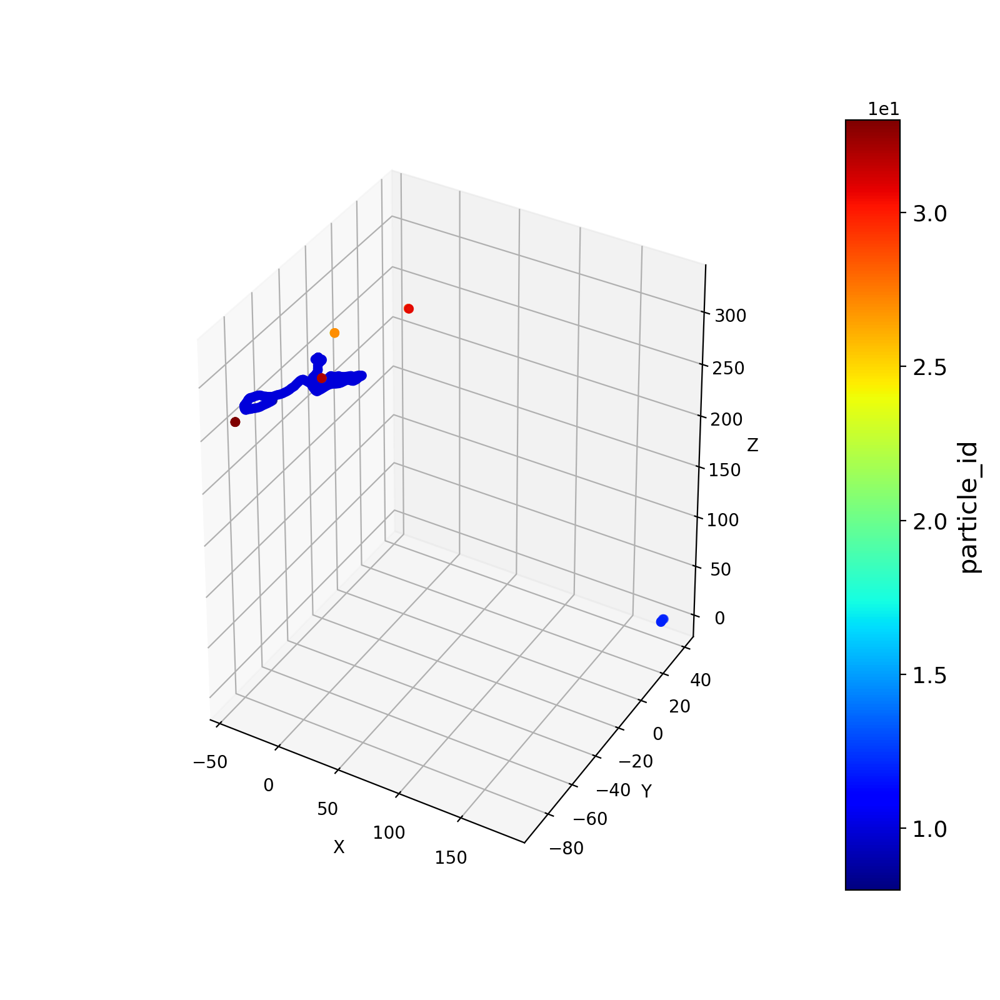

<IPython.core.display.Javascript object>


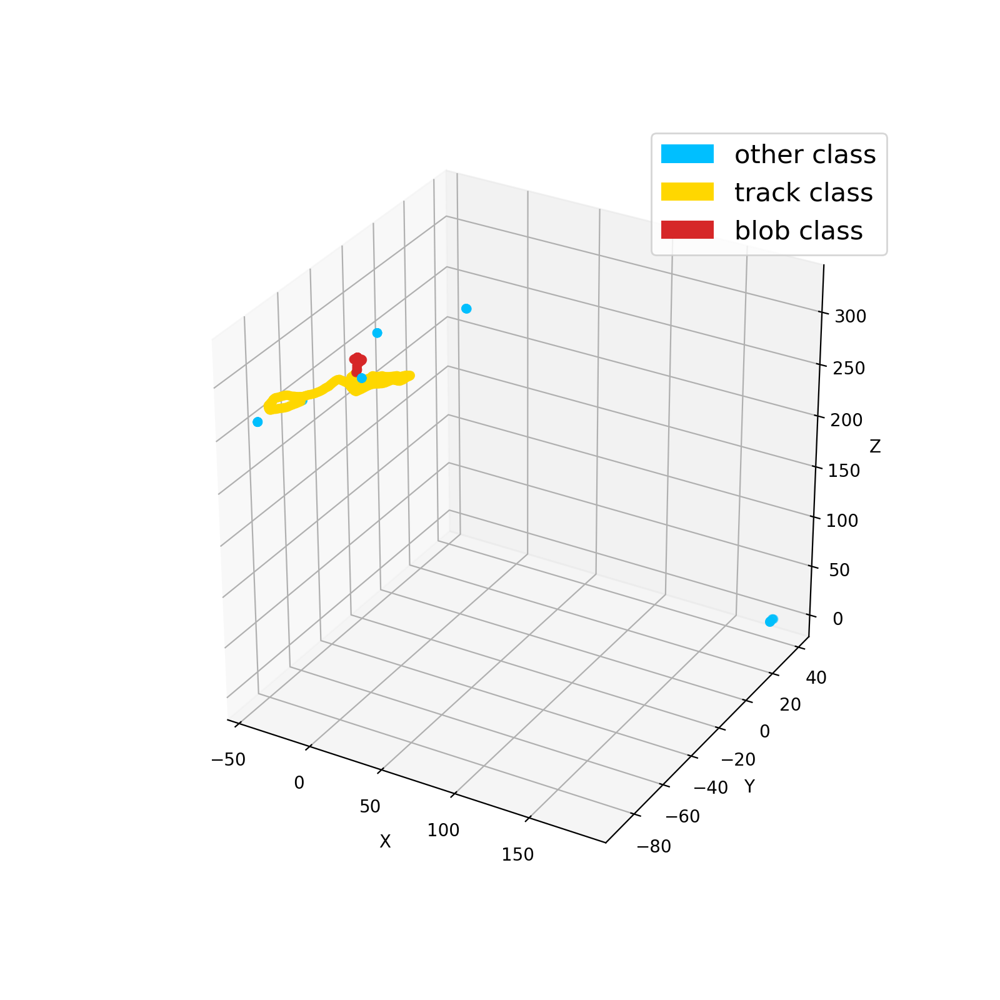

<IPython.core.display.Javascript object>


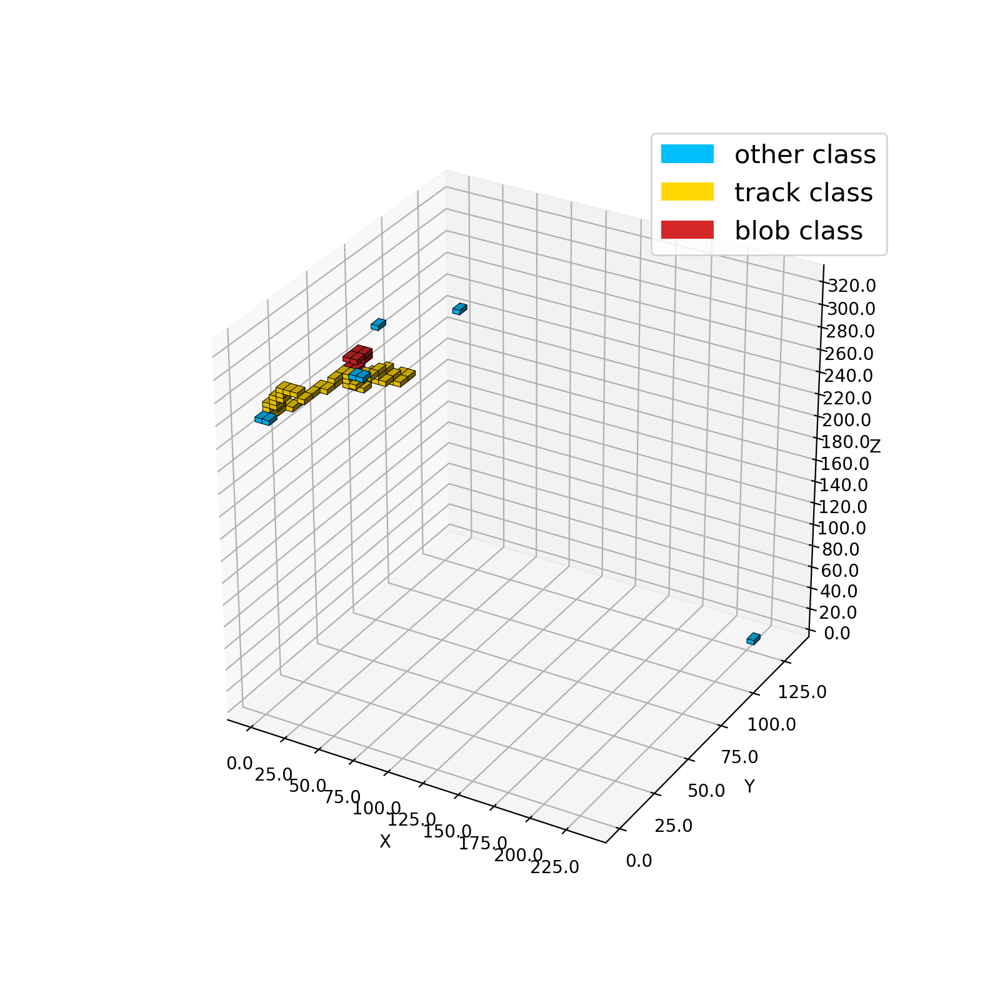

<IPython.core.display.Javascript object>


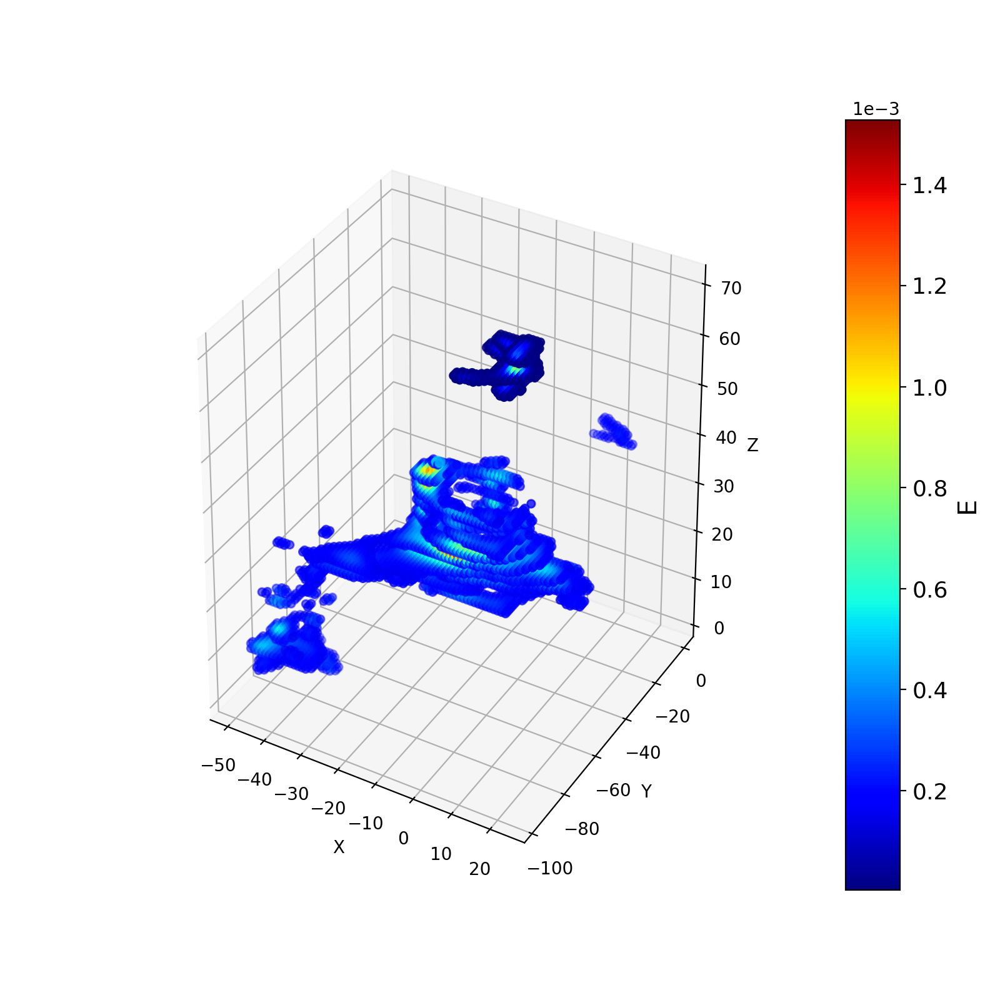

<IPython.core.display.Javascript object>


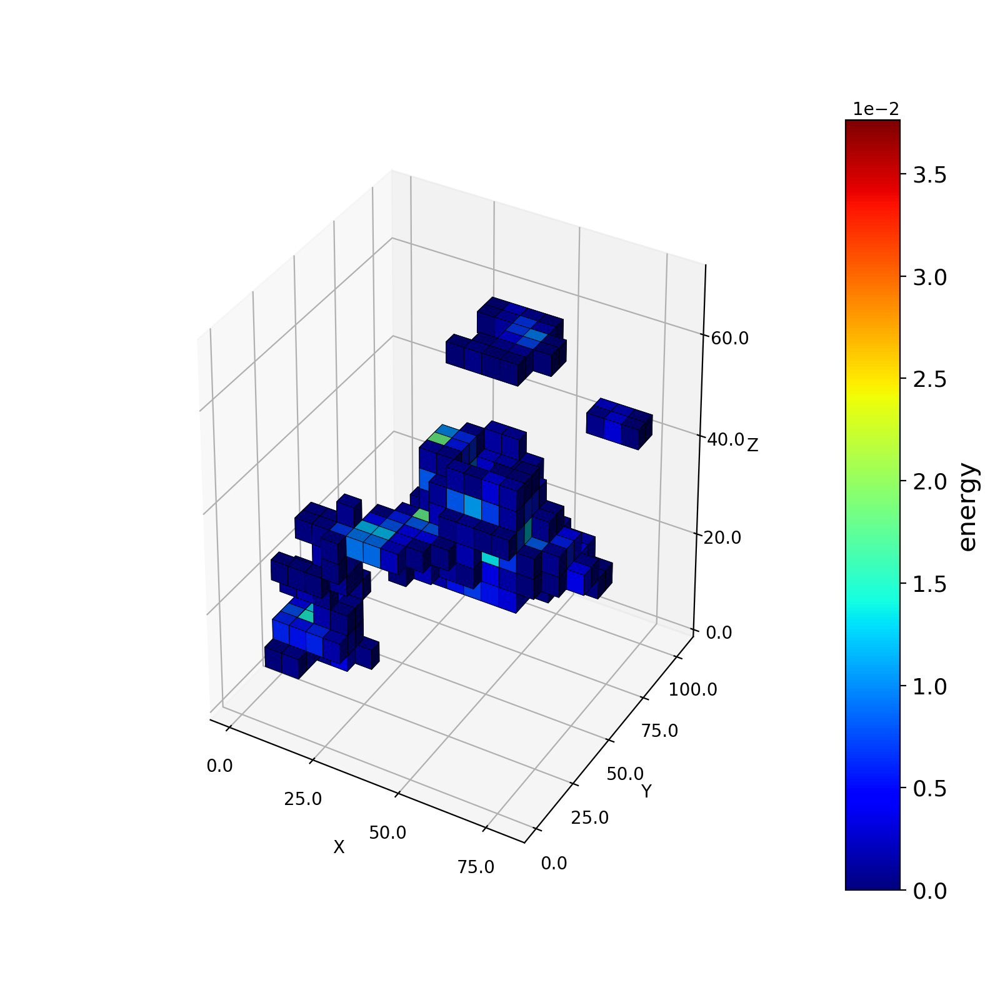

<IPython.core.display.Javascript object>


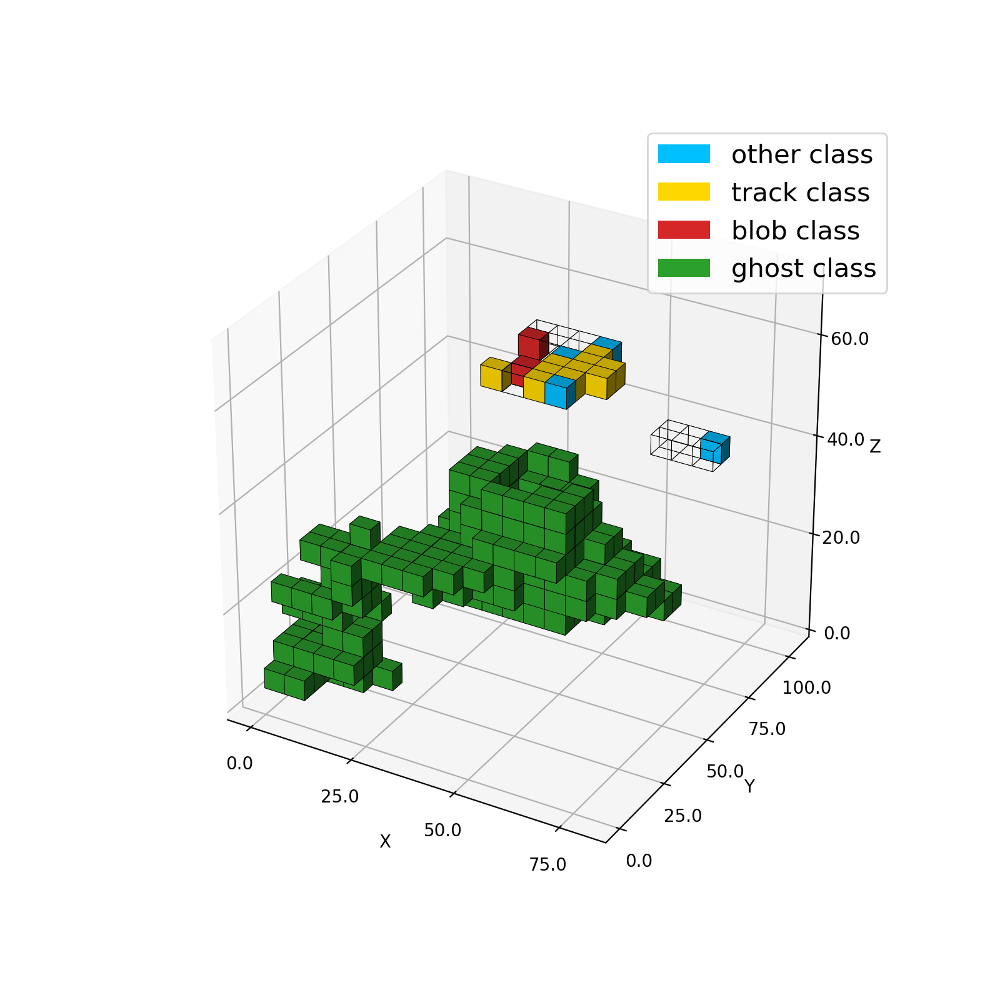

<IPython.core.display.Javascript object>


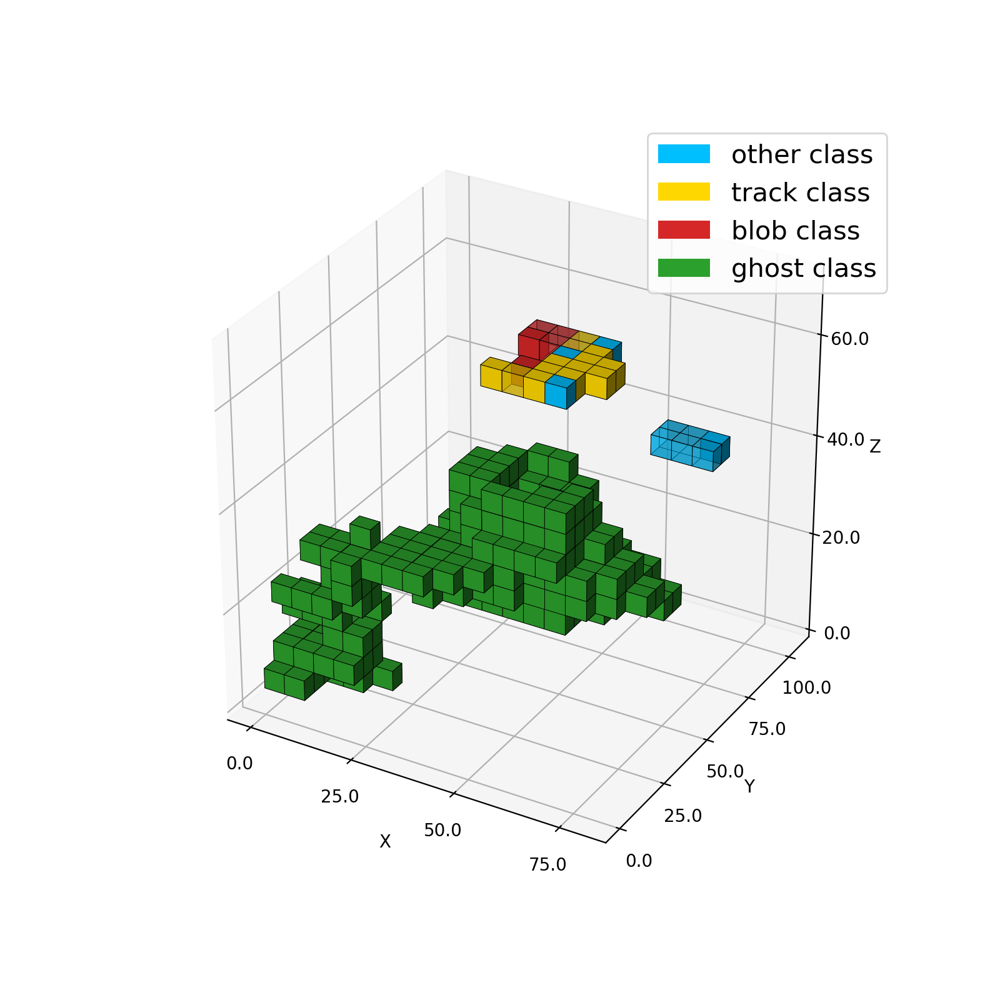

<IPython.core.display.Javascript object>


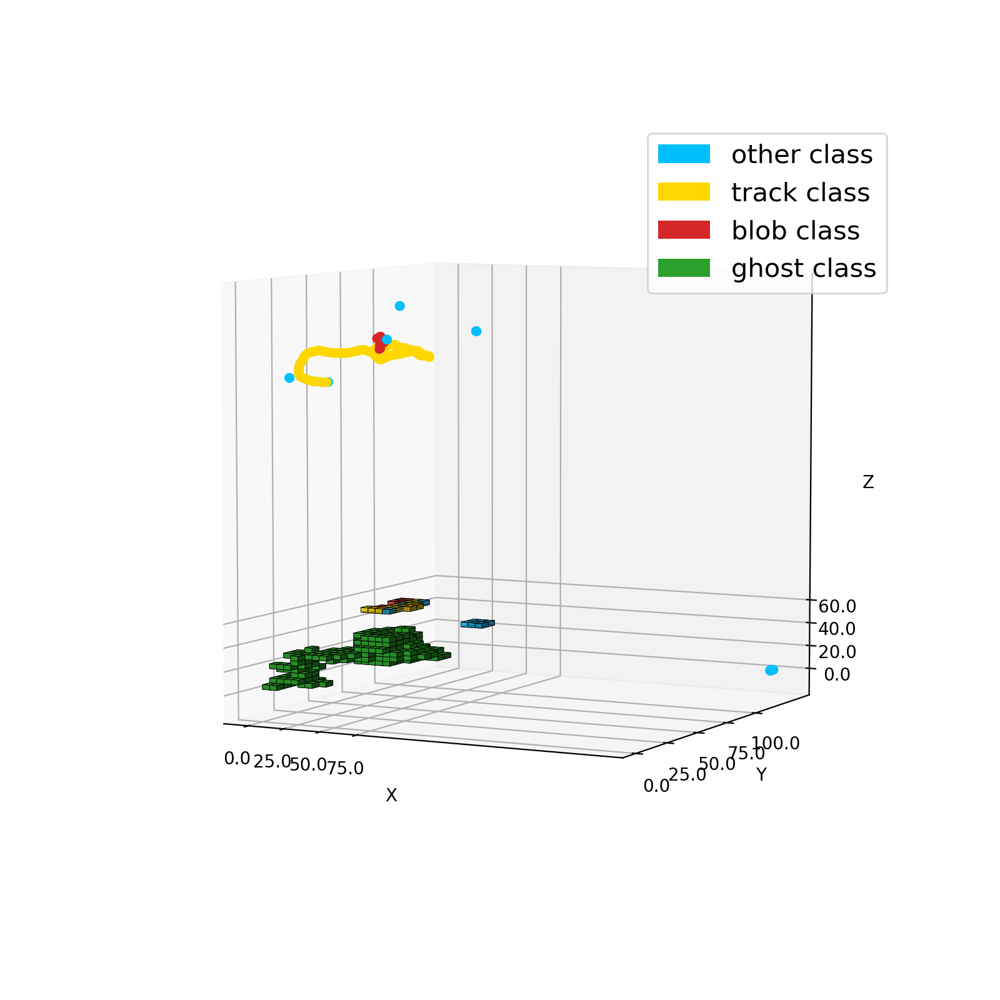

In [107]:
%matplotlib notebook

plot_3d_hits(event_MC_hits, value = 'particle_id') 
plot_3d_hits_discrete(event_MC_hits)
plot_cloud_voxels_and_hits_discrete(event_MC_voxels, pd.DataFrame(), voxel_size, start_bin, coords = ['x', 'y', 'z'], opacity = [1, 0.5])

plot_3d_hits(event_beersh_hits, value = 'E', coords = ['X', 'Y', 'Z'])
plot_3d_vox(event_beersh_vox, voxel_size, value = 'energy', coords = ['xbin', 'ybin', 'zbin'])

plot_cloud_voxels_and_hits_discrete(event_beersh_vox, pd.DataFrame(), voxel_size, start_bin, opacity = [1, 0])


plot_cloud_voxels_and_hits_discrete(event_beersh_vox, pd.DataFrame(), voxel_size, start_bin, opacity = [1, 0.6])

plot_cloud_voxels_and_hits_discrete(event_beersh_vox, event_MC_hits, voxel_size, start_bin, opacity = [0.6, 0.6, 1])




In [577]:
eventInfo[(eventInfo.basename == 'Tl208_NEW_v1_03_01_nexus_v5_03_04_cut50.beersheba_6206.root.h5') & (eventInfo.event_id == 100000247)]



,event_id,binclass,dataset_id,pathname,basename,label_pathname,label_basename
3203,100000247,1,3203,/mnt/lustre/scratch/home/usc/ie/mpm/data_produ...,Tl208_NEW_v1_03_01_nexus_v5_03_04_cut50.beersh...,/mnt/lustre/scratch/home/usc/ie/mpm/beersh_lab...,Tl208_NEW_v1_03_01_nexus_v5_03_04_cut50.beersh...


In [493]:
color_dict = {1:'deepskyblue', 2:'gold', 3:'tab:red', 4:'deepskyblue', 5:'gold', 6:'tab:red', 7:'tab:green'}

In [346]:
labelled_voxels = event_beersh_vox.copy()
labelled_hits = event_MC_hits.copy()
coords = ['xbin', 'ybin', 'zbin']
value = ['segclass', 'segclass', 'segclass']
affluence = (2, 2, 2)
coords_mc = ['x', 'y', 'z']
th=0
edgecolor='k'
linewidth = .3
opacity = [0, 1, 1]

In [347]:
scaled_hits = plot_adaption_hits_to_voxel_scale(labelled_hits, voxel_size, start_bin)

In [348]:
scaled_hits

,x,y,z,hit_id,particle_id,energy,segclass,binclass,dist_hits,cumdist,particle_name,creator_proc,group_ener,small_b,dataset_id
80404,37.853786,82.939072,75.409721,0,9,0.004713,2.0,0,0.000000,0.000000,e-,compt,1.154811,False,324
80405,37.882969,82.756958,75.316826,1,9,0.003437,2.0,0,0.994204,0.994204,e-,compt,1.154811,False,324
80406,37.927429,82.580933,75.215553,2,9,0.001141,2.0,0,0.994054,1.988257,e-,compt,1.154811,False,324
80407,37.986481,82.406952,75.118462,3,9,0.003615,2.0,0,0.997380,2.985638,e-,compt,1.154811,False,324
80408,38.060211,82.259903,74.976501,4,9,0.007564,2.0,0,0.999460,3.985098,e-,compt,1.154811,False,324
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80687,36.252628,66.788841,79.866531,4,20,0.008770,1.0,0,0.000000,0.000000,e-,eIoni,0.058882,False,324
80688,36.254608,66.783920,79.874008,5,20,0.021220,1.0,0,0.000000,0.000000,e-,eIoni,0.058882,False,324
80689,37.501331,64.824730,82.125069,0,21,0.006403,1.0,0,0.000000,0.000000,e-,phot,0.016554,False,324
80690,37.501167,64.826874,82.123367,1,21,0.005970,1.0,0,0.000000,0.000000,e-,phot,0.016554,False,324


In [291]:
xcoord  = labelled_voxels[coords[0]].values
ycoord  = labelled_voxels[coords[1]].values
zcoord  = labelled_voxels[coords[2]].values
content = labelled_voxels[value[0]].values

xmin, xmax = min(xcoord), max(xcoord)
ymin, ymax = min(ycoord), max(ycoord)
zmin, zmax = min(zcoord), max(zcoord)

labels, ticks = plot_label_creator((xmin, ymin, zmin), (xmax, ymax, zmax), voxel_size, affluence)

nbinsX = int(np.ceil((xmax-xmin))) + 2
nbinsY = int(np.ceil((ymax-ymin))) + 2
nbinsZ = int(np.ceil((zmax-zmin))) + 2


mc_label = labelled_voxels[np.isin(labelled_voxels.segclass, (1, 2, 3))]
cloud    = labelled_voxels[np.isin(labelled_voxels.segclass, (4, 5, 6))]
ghost    = labelled_voxels[np.isin(labelled_voxels.segclass, 7)]



In [401]:
xarr = np.zeros(shape=(nbinsX, nbinsY, nbinsZ), dtype = 'U16') 

In [402]:
nonzeros = np.vstack([cloud[coords[0]].values-xmin,
                          cloud[coords[1]].values-ymin,
                          cloud[coords[2]].values-zmin])

In [403]:
#nonzeros = nonzeros.astype(int)

In [471]:
color_dict = {1:'royalblue', 2:'gold', 3:'tab:red', 4:'royalblue', 5:'gold', 6:'tab:red', 7:'green'}